## Complete algorithm - Ueckermünde Data

This will be the collection of all the code used during the analysis and development of the retention time algorithm. This notebook will be devided in six chapters:

Chapter 1 - EDA

Chapter 2 - Pumping operation times

Chapter 3 - ART calculation

Chapter 4 - Plotting results

Chapter 5 - Probability and statistical analysis

Chapter 6 - Nitrate Dosing Concept

## Result Summery

**Fit between ART_flow & ART_temp:**

**Departure ART:**
- Mean Root Squared Error = % (with outliers removed)
- R² = 
- t-Test: No significant difference found (p-value = )

**Arrival ART:**
- Mean Root Squared Error = % (with outliers removed)
- R² = 
- t-Test: No significant difference found (p-value = )

**Probability Analysis:**
- **81.0%** probability of temperature change occuring within 15 minutes of a pumping event 


In [1]:
# Import libraries
import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
sns.set()

from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
import cufflinks as cf
init_notebook_mode(connected=True)
cf.go_offline()
import plotly.express as px

from sklearn.linear_model import LinearRegression
import statsmodels.api as sm

from datetime import datetime
from datetime import timedelta


In [2]:
# Import datasets
data1 = pd.read_json('Data/df_sulfi_clean') #temperature & h2s data
data2 = pd.read_json('Data/Flow_clean')# flow data

In [3]:
# join datasets
data = pd.concat([data1,data2], axis = 1)

#rename flow rate column 
data['Q'] = data['Durchfluss AW[m³/h]']
data.drop('Durchfluss AW[m³/h]', axis = 1, inplace= True)

data.head()

,H2S_aq,T_ww,Q
2019-08-26 00:00:00,NaN,NaN,0.40
2019-08-26 00:01:00,NaN,NaN,0.35
2019-08-26 00:02:00,NaN,NaN,0.35
2019-08-26 00:03:00,NaN,NaN,4.57
2019-08-26 00:04:00,NaN,NaN,11.25


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 368035 entries, 2019-08-26 00:00:00 to 2020-04-19 23:59:00
Data columns (total 3 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   H2S_aq  288926 non-null  float64
 1   T_ww    288926 non-null  float64
 2   Q       274520 non-null  float64
dtypes: float64(3)
memory usage: 11.2 MB


In [ ]:
# Plot Time Series
## This is a very big plot (>80 MB) execute only when needed

import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=data.index, y=data['Q'], name="Flow Rate [m³/h]"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=data.index, y=data['T_ww'], name="Temperature [°C]", 
               line = dict(width= 0.9)), secondary_y=True,           
)

fig.add_trace(
    go.Scatter(x=data.index, y=data['H2S_aq'], name="H2S [mg/L]", 
               line = dict(width= 0.9)), secondary_y=True,           
)

# Add figure title
#fig.update_layout(title_text="Ueckermünde project")

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.75
))


# Set x-axis title
fig.update_xaxes(title_text="Date")

fig.update_yaxes(automargin=True)
fig.update_xaxes(automargin=True)
fig.show()

## **Data from 6.1.2020 untill 18.2.2020 is the most consistant and with the laset amount of missing values**

In [6]:
# Choose sample from 2020-1-6 to 2020-2-19 parameters (12,10) error 0.1156
data = data.loc['2020-1-6':'2020-2-18']

data.head()

,H2S_aq,T_ww,Q
2020-01-06 00:00:00,0.136,7.8,1.23
2020-01-06 00:01:00,0.145,7.8,1.23
2020-01-06 00:02:00,0.147,7.7,1.05
2020-01-06 00:03:00,0.139,7.7,0.88
2020-01-06 00:04:00,0.134,7.6,0.93


# Chapter 1 - EDA

In [7]:
# Plot Time Series
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Add traces
fig.add_trace(
    go.Scatter(x=data.index, y=data['Q'], name="Flow Rate [m³/h]"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=data.index, y=data['T_ww'], name="Temperature [°C]", 
               line = dict(width= 0.9)), secondary_y=True,           
)

fig.add_trace(
    go.Scatter(x=data.index, y=data['H2S_aq'], name="H2S [mg/L]", 
               line = dict(width= 0.9)), secondary_y=True,           
)

# Add figure title
#fig.update_layout(title_text="BWB Pilotplant project")

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.75
))
# Set x-axis title
fig.update_xaxes(title_text="Date")

fig.update_yaxes(automargin=True)
fig.update_xaxes(automargin=True)
fig.show()

In [8]:
data.describe()

,H2S_aq,T_ww,Q
count,63438.000000,63438.000000,61918.000000
mean,0.457852,7.819151,8.033171
std,1.159216,0.478234,12.755026
min,0.000000,5.100000,0.000000
25%,0.098000,7.700000,0.700000
50%,0.155000,7.900000,2.110000
75%,0.364000,8.100000,8.670000
max,14.225000,10.100000,64.800000


In [9]:
data['KW'] = data.index.map(lambda x: x.date().isocalendar()[1])

## H2S data

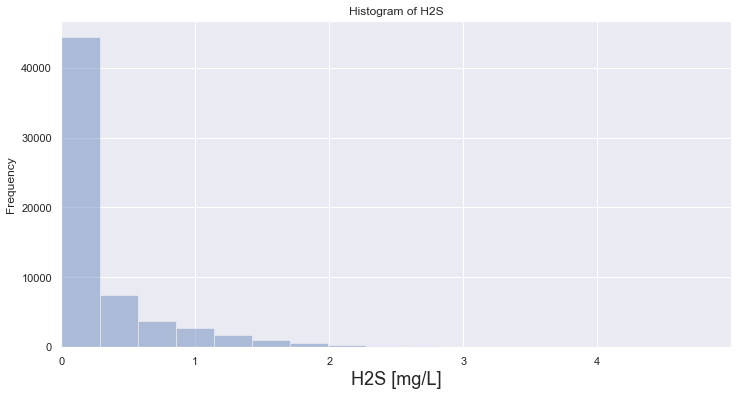

In [10]:
# H2S data distribution

plt.figure(figsize=(12,6))
sns.distplot(data['H2S_aq'], kde  =False)

plt.ylabel('Frequency ')
plt.xlabel('H2S [mg/L]',fontsize=18);
plt.title('Histogram of H2S')

plt.xticks(np.arange(0,5))
plt.xlim(0,5);

sns.set(font_scale = 2)
plt.show()


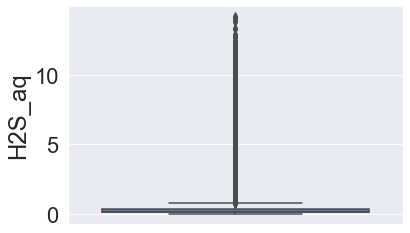

In [11]:
# H2S data
fig, ax = plt.subplots()
sns.boxplot(y = data['H2S_aq'], ax=ax)
plt.show();

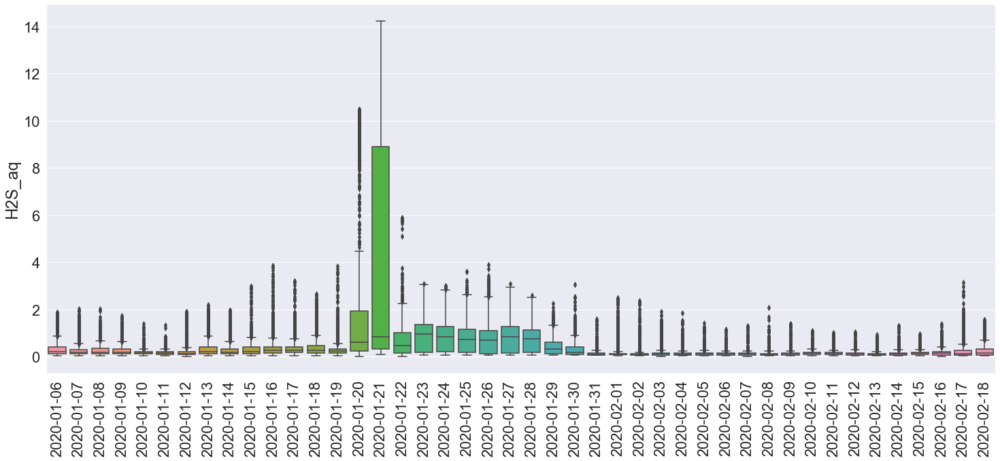

In [12]:
# H2S data per day
fig, ax = plt.subplots(figsize=(25,10))
sns.boxplot(data['H2S_aq'].index.date, data['H2S_aq'], ax=ax)
plt.xticks(rotation=90)
plt.show()

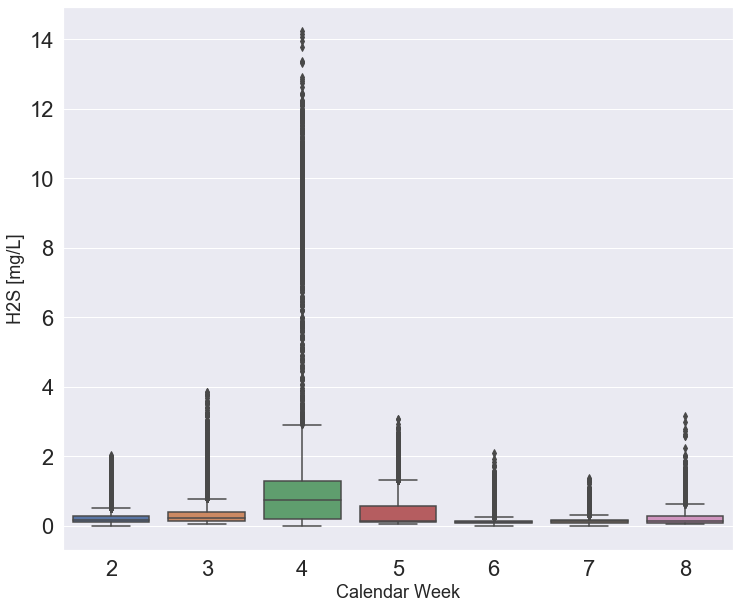

In [13]:
# H2S data per day
fig, ax = plt.subplots(figsize=(12,10))
sns.boxplot(data['KW'], data['H2S_aq'], ax=ax)
plt.xticks(rotation=0)
#ax.legend(loc='upper left', fontsize=20,bbox_to_anchor=(0, 1.1))
ax.set_xlabel('Calendar Week',fontsize=18);
ax.set_ylabel('H2S [mg/L]',fontsize=18);
sns.set(font_scale = 2)
plt.show()


In [14]:
# Example of H2S time series 

fig = px.line(data.loc['2020-1-26']['H2S_aq'], y="H2S_aq",
                   title='',
                   labels={'H2S_aq':'H2S [mg/L]','index':''}
                  )
fig.show()

In [15]:
# Create new dataframe called df based on original dataset 'data'
data_h2s = data.reset_index()

# Add day of the week column 
dmap = {0:'Mon',1:'Tue',2:'Wed',3:'Thu',4:'Fri',5:'Sat',6:'Sun'}
data_h2s['Day of Week'] = data_h2s['index'].apply(lambda x: x.weekday()).apply(lambda x: dmap[x])

data_h2s.set_index('index',inplace = True)
data_h2s.drop(['Q','T_ww'],axis = 1, inplace = True)
#data_h2s.head()


In [16]:
data_h2s_grouped = data_h2s.groupby([data_h2s.index.date,data_h2s['Day of Week'],data_h2s.index.time]).mean()
data_h2s_grouped.rename_axis(index=['Date','Day of Week', 'Time'], inplace = True)

# Pivot data set so that Date and Day of Week are columns and Time is the index
df_H2S = data_h2s_grouped.pivot_table(index = 'Time', columns = ['Date','Day of Week'],values ='H2S_aq')
#df_H2S.head()

In [17]:
# Smooth data using exponentially weighted window function .ewm()
time_series_smoothed = df_H2S.ewm(span = 180).mean()

In [18]:
#Six day plot of H2S concentrations
#
week = 2
i = True
date = datetime(2020,1,6).date()
while date < time_series_smoothed.columns.get_level_values('Date')[-1]:
    
    while i:
        date += timedelta(days=6)
        time_series_smoothed.iloc[:,((time_series_smoothed.columns.get_level_values('Date')) <= date) & 
                        ((time_series_smoothed.columns.get_level_values('Date')) >= (date - timedelta(days=6)))].iplot(title = 'Week 1')
        i = False
        break
        
    date += timedelta(days=7)
    time_series_smoothed.iloc[:,((time_series_smoothed.columns.get_level_values('Date')) <= date) & 
                        ((time_series_smoothed.columns.get_level_values('Date')) > (date - timedelta(days=7)))].iplot(title = f'Week {week}')
    week += 1


In [19]:
#Plot data for weekends
time_series_smoothed.iloc[:, (time_series_smoothed.columns.get_level_values('Day of Week') =='Sat') | 
                (time_series_smoothed.columns.get_level_values('Day of Week') =='Sun') ].iplot(title = 'Weekends')

#Plot data for weekdays
time_series_smoothed.iloc[:, (time_series_smoothed.columns.get_level_values('Day of Week') !='Sat') & 
                (time_series_smoothed.columns.get_level_values('Day of Week') !='Sun') ].iplot(title = 'Weekdays')

In [20]:
#data['H2S_aq'].groupby(data['H2S_aq'].index.hour).mean().iplot()

avg_h2s = data.groupby(data.index.hour).mean().drop(['T_ww','Q'], axis = 1)

avg_h2s.index = pd.to_datetime(avg_h2s.index, format= '%H').strftime('%H:%M')


fig = px.line(avg_h2s,y = avg_h2s['H2S_aq'],
              title='',labels={'index':'','H2S_aq':'H2S [mg/L]'})

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=25,tickangle = 45)
fig.update_yaxes(nticks=15, tickangle = 0)


fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))




fig.show()


## Temperature Data

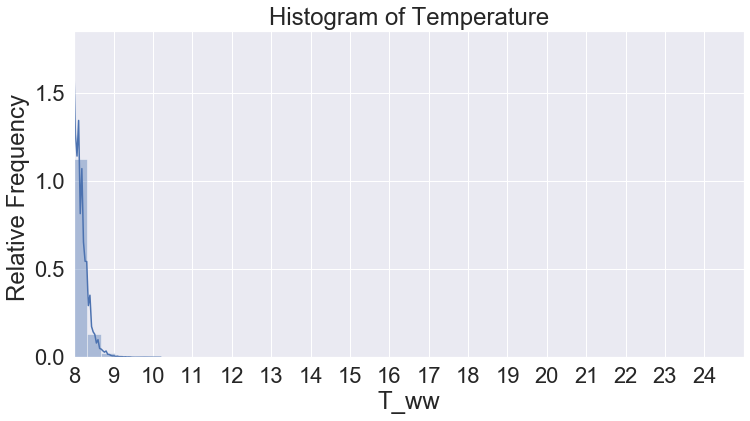

In [21]:
# Temperature data distribution
plt.figure(figsize=(12,6))
sns.distplot(data['T_ww'], bins = 14)

plt.ylabel('Relative Frequency ')
plt.title('Histogram of Temperature')


plt.xticks(np.arange(8,25))
plt.xlim(8,25);

ax.set_xlabel('Temperature [°C]',fontsize=18);
#ax.set_ylabel('Relative Frequency',fontsize=18);
sns.set(font_scale = 2)
plt.show()


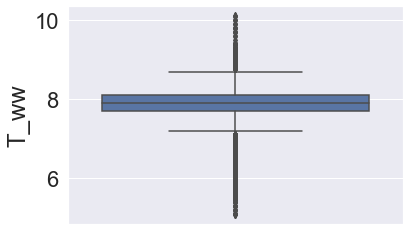

In [22]:
# temperature data
fig, ax = plt.subplots()
sns.boxplot(y = data['T_ww'], ax=ax)
plt.show()

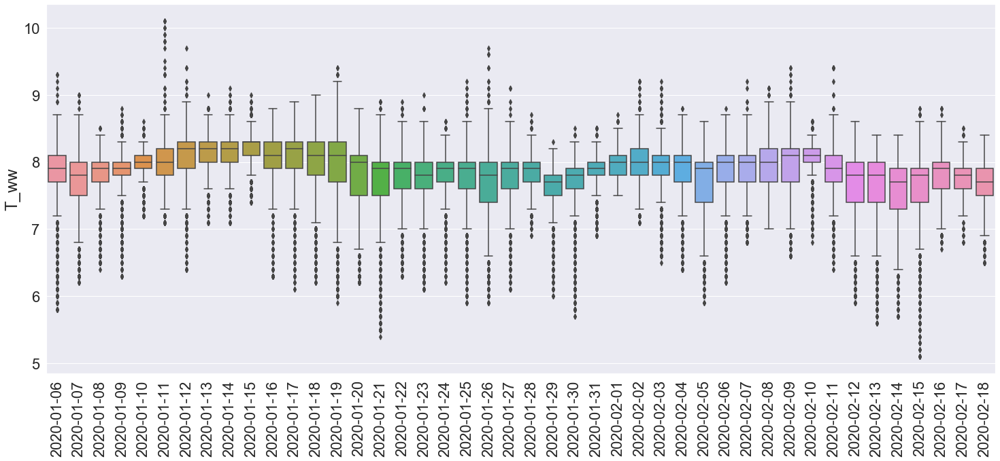

In [23]:
# temperature data per day
fig, ax = plt.subplots(figsize=(25,10))
sns.boxplot(data['T_ww'].index.date, data['T_ww'], ax=ax)
plt.xticks(rotation=90)
plt.show()

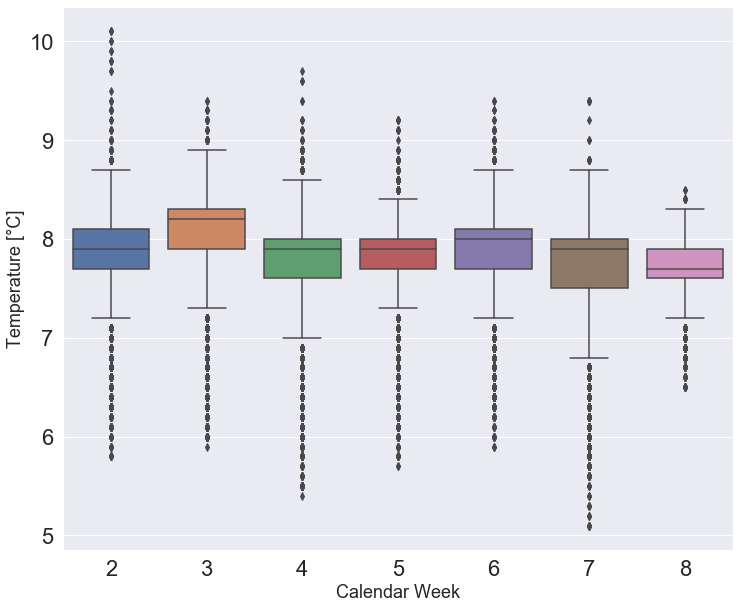

In [24]:
# temperature data per day

fig, ax = plt.subplots(figsize=(12,10))
sns.boxplot(data['KW'], data['T_ww'], ax=ax)
plt.xticks(rotation=0)
#ax.legend(loc='upper left', fontsize=20,bbox_to_anchor=(0, 1.1))
ax.set_xlabel('Calendar Week',fontsize=18);
ax.set_ylabel('Temperature [°C]',fontsize=18);
sns.set(font_scale = 2)
plt.show()

In [25]:
# Example of Temperature time series 

fig = px.line(data.loc['2020-1-26']['T_ww'], y="T_ww",
                   title='',
                   labels={'T_ww':'Temperature [°C]','index':''}
                  )
fig.show()

#data.loc['2019-11-26']['T_ww'].iplot(yTitle = 'Temperature [°C]')

## Flow Rate Data

In [26]:
# Flow Rate data distribution

fig = px.histogram(data.rolling(window=60).mean(), x="Q",
                   nbins = 90,
                   title='Histogram of hourly Flow rate',
                   labels={'Q':'Flow Rate [m³/h]'},
                  histnorm='probability density')
fig.show()


#data['Q'].iplot(kind = 'hist', bins = 90
                       #, title = 'Distribution of Flow Rate',
                     #colors = 'green',
                    # xTitle = 'Flow Rate [m³/h]',
                     #yTitle = 'Frequency', 
                #histnorm = 'probability density' ,)

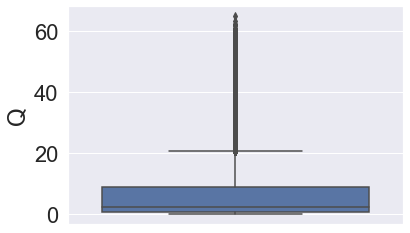

In [27]:
# Flow ratedata
fig, ax = plt.subplots()
sns.boxplot(y = data['Q'], ax=ax)
plt.show()

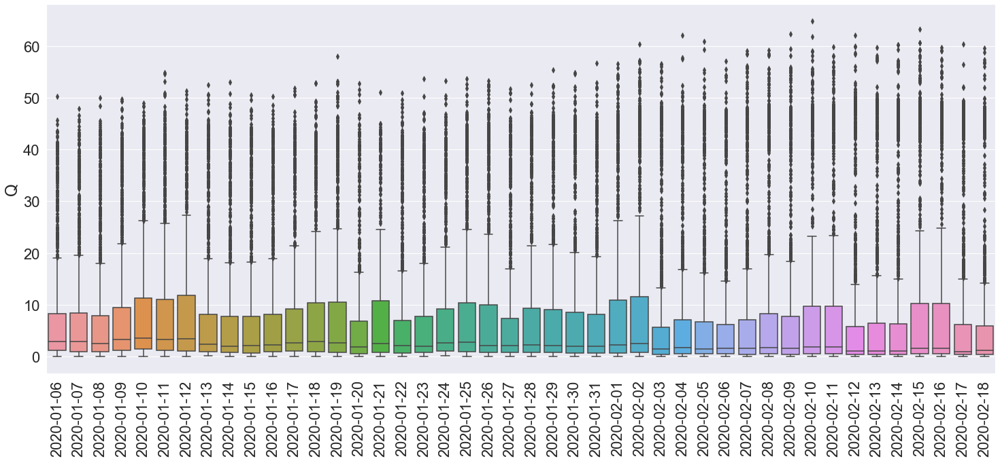

In [28]:
# flow rate data per day
fig, ax = plt.subplots(figsize=(25,10))
sns.boxplot(data['Q'].index.date, data['Q'], ax=ax)
plt.xticks(rotation=90)
plt.show()

In [29]:
# Example of Flow Rate time series 
fig = px.line(data.loc['2020-1-26']['Q'], y="Q",
                   title='',
                   labels={'Q':'Flow Rate [m³/h','index':''}
                  )
fig.show()


#data.loc['2019-11-26']['Q'].iplot(yTitle = 'Flow Rate [m³/h]')


## Temperature and Flow Rate

In [30]:
# Create figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])


# Add traces
fig.add_trace(
    go.Scatter(x=data.loc['2020-1-24':'2020-1-26'].index, 
               y=data.loc['2020-1-24':'2020-1-26']['Q'], 
               name="Flow Rate [m³/h]"),
    secondary_y=False,
)

fig.add_trace(
    go.Scatter(x=data.loc['2020-1-24':'2020-1-26'].index,
               y=data.loc['2020-1-24':'2020-1-26']['T_ww'],
               name="Temperature [°C]", 
               line = dict(width= 0.9)), secondary_y=True,           
)

# Add figure title
#fig.update_layout(title_text="")
# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.75
))
# Set x-axis title
fig.update_xaxes(title_text="Date")
fig.update_yaxes(title_text="Temperature [°C]",secondary_y=True)
fig.update_yaxes(title_text="Flow Rate [m³/h]",secondary_y=False)


fig.update_yaxes(automargin=True)
fig.update_xaxes(automargin=True)
fig.show()

# Chapter 2 - Pumping Operation Times

## 2.1 Flow Data

In [31]:
d = data['Q']#.rolling(window=5).mean()
df_flow = pd.DataFrame(data = d.values, columns= ['Flow_Rate'], index = d.index)
#df_flow.dropna(inplace = True)

**Determine pump on & off times**

To find pumping times we will use the following condition:

- When flow is >= 10 m³/h --> pump is on
- When flow is <  10 m³/h --> pump is off


In [32]:
# Create new feature called Pump_ON
# Value 1 = pump is on, value 0 = pump is off

df_flow['Pump_ON'] = df_flow['Flow_Rate'].apply(lambda x: 1 if x >= 10 else 0)
df_flow.head()

,Flow_Rate,Pump_ON
2020-01-06 00:00:00,1.23,0
2020-01-06 00:01:00,1.23,0
2020-01-06 00:02:00,1.05,0
2020-01-06 00:03:00,0.88,0
2020-01-06 00:04:00,0.93,0


* Create function that retrieves start and stop times based on the consecutive values in the column 'Pump_ON' that are equal to 1

In [33]:
# Function returns dataset with timestamps of pump start
# and pump stop

def pumping(data):
    
    pump_duration = []
    pump_start = []
    pump_stop = []
    
    numList = data['Pump_ON'].values
    i = 0

    while i < len(numList) - 1:
        n = numList[i]
        startIndex = i
        if numList[i] == 1:
            while i < len(numList) - 1 and numList[i] == numList[i + 1]:
                i = i + 1

            endIndex = i
            
            pump_start.append(df_flow.iloc[startIndex].name)
            pump_stop.append(df_flow.iloc[endIndex].name)      
            
        i = i + 1
    
    d = {'Pump_Start': pump_start, 'Pump_Stop': pump_stop}
    return pd.DataFrame(data = d )

In [34]:
df_pump_flow = pumping(df_flow)
#Add column called 'Duration' to df_pump_flow
df_pump_flow['Duration'] = (df_pump_flow['Pump_Stop'] - df_pump_flow['Pump_Start'])
df_pump_flow.head()

,Pump_Start,Pump_Stop,Duration
0,2020-01-06 00:42:00,2020-01-06 00:42:00,00:00:00
1,2020-01-06 00:48:00,2020-01-06 00:55:00,00:07:00
2,2020-01-06 01:59:00,2020-01-06 02:00:00,00:01:00
3,2020-01-06 02:16:00,2020-01-06 02:23:00,00:07:00
4,2020-01-06 03:32:00,2020-01-06 03:32:00,00:00:00


In [35]:
df_pump_flow.describe()

,Duration
count,3699
mean,0 days 00:02:54.160583
std,0 days 00:03:18.833447
min,0 days 00:00:00
25%,0 days 00:00:00
50%,0 days 00:01:00
75%,0 days 00:06:00
max,0 days 00:14:00


* Locate rows with pumping duration = 0

In [36]:
df_pump_flow[df_pump_flow['Duration'] < timedelta(minutes = 1)]

,Pump_Start,Pump_Stop,Duration
0,2020-01-06 00:42:00,2020-01-06 00:42:00,0 days
4,2020-01-06 03:32:00,2020-01-06 03:32:00,0 days
6,2020-01-06 05:06:00,2020-01-06 05:06:00,0 days
8,2020-01-06 05:58:00,2020-01-06 05:58:00,0 days
10,2020-01-06 06:31:00,2020-01-06 06:31:00,0 days
...,...,...,...
3691,2020-02-18 22:06:00,2020-02-18 22:06:00,0 days
3692,2020-02-18 22:11:00,2020-02-18 22:11:00,0 days
3693,2020-02-18 22:16:00,2020-02-18 22:16:00,0 days
3695,2020-02-18 23:00:00,2020-02-18 23:00:00,0 days


In [37]:
#drop all rows where pumping duration = 0
df_pump_flow = df_pump_flow[df_pump_flow['Duration'] != timedelta(minutes = 0)]

In [38]:
df_pump_flow.describe()

,Duration
count,1917
mean,0 days 00:05:36.056338
std,0 days 00:02:27.885206
min,0 days 00:01:00
25%,0 days 00:05:00
50%,0 days 00:06:00
75%,0 days 00:07:00
max,0 days 00:14:00


* Locate rows with pumping duration > 60

In [39]:
df_pump_flow[df_pump_flow['Duration'] > timedelta(minutes = 60)]

,Pump_Start,Pump_Stop,Duration


In [40]:
# Pumping events per day
# Create dataset with date as index and pump start as values

d = pd.DataFrame(data = np.ones(len(df_pump_flow.index)),
                         index= df_pump_flow['Pump_Start'].values,
                         columns= ['Pump_Start'] )

pump_start = pd.concat([df_flow['Flow_Rate'],d],axis = 1)
pump_start.fillna(0, inplace = True)
pump_start.head()

,Flow_Rate,Pump_Start
2020-01-06 00:00:00,1.23,0.0
2020-01-06 00:01:00,1.23,0.0
2020-01-06 00:02:00,1.05,0.0
2020-01-06 00:03:00,0.88,0.0
2020-01-06 00:04:00,0.93,0.0


In [41]:
pump_freq = pump_start.groupby(pump_start.index.date).sum().drop('Flow_Rate', axis = 1)
pump_freq.head()

,Pump_Start
2020-01-06,38.0
2020-01-07,36.0
2020-01-08,35.0
2020-01-09,36.0
2020-01-10,47.0


In [42]:
fig = px.bar(pump_freq, y="Pump_Start",
                   title='Pump Starts per day',
                   labels={'Pump_Start':'Count','index':''}
                  )
fig.show()

In [43]:
pump_freq.describe()

,Pump_Start
count,44.000000
mean,43.568182
std,7.484551
min,21.000000
25%,39.750000
50%,44.500000
75%,49.000000
max,59.000000


### Pumping frequency

In [44]:
#pumping frequency
pump_intervals = pump_start[pump_start['Pump_Start'] == 1]
pump_intervals = pump_intervals.groupby([pump_intervals.index.date, pump_intervals.index.time]).mean()

pump_intervals.rename_axis(index=['Date', 'Time'], inplace = True)

In [45]:
pump_intervals = pump_start[pump_start['Pump_Start'] == 1]
check_freq = pump_intervals[(pump_intervals.index.hour >= 0) & 
                           (pump_intervals.index.hour <= 6)]
check_freq.head()

,Flow_Rate,Pump_Start
2020-01-06 00:48:00,28.36,1.0
2020-01-06 01:59:00,10.60,1.0
2020-01-06 02:16:00,22.73,1.0
2020-01-06 04:07:00,18.63,1.0
2020-01-06 05:20:00,24.72,1.0


In [46]:
#Get frequency of discharges and save in dataframe
freqs = []
days = []

for day in check_freq.index.date:
    df_dis = check_freq[check_freq.index.date == day]
    count = []
    for i  in range (len(df_dis)-1):
        
        start = datetime.combine(day,df_dis.index.time[i]) 
        stop = datetime.combine(day,df_dis.index.time[i+1]) 
        
        count.append((stop - start).total_seconds() / 60) #frequency in minutes
    i +=1                
    freqs.append(np.array(count).mean())
    days.append(day)

datafreq2 = pd.DataFrame(data = {'Frequency' : freqs}, index = days)

In [47]:
datafreq2.describe()

,Frequency
count,318.000000
mean,58.677677
std,11.811616
min,31.666667
25%,52.714286
50%,59.000000
75%,67.500000
max,80.200000


## 2.2 Temperature Data

In [48]:
d = data['T_ww']#.rolling(window = 5).mean()
df_temp = pd.DataFrame(data = d.values, columns= ['T_ww'], index = d.index)
#df_temp.dropna(inplace = True)

In [49]:
# Smooth data -

best_fit = (14, 5) # parameters that produce best fit with actual ART (8,7 -  12,5 m³/h)  - 15, 5 - 17,2

time_series = pd.DataFrame(data = d.values, columns= ['T_ww'], index = d.index)
time_series[f'EWMA{best_fit[0]}'] = time_series['T_ww'].ewm(span = best_fit[0], adjust = False).mean()

from scipy.signal import find_peaks
from scipy.signal import argrelextrema

# detect peaks
indices_peak = find_peaks(time_series[f'EWMA{best_fit[0]}'].values, distance= best_fit[1])[0]
peak_timestamp = [time_series.index[i] for i in indices_peak]
peak = [time_series[f'EWMA{best_fit[0]}'].values[j] for j in indices_peak]

#detect minimas
indices_minima = argrelextrema(time_series[f'EWMA{best_fit[0]}'].values, np.less, order = best_fit[1])[0]
minima_timestamp = [time_series.index[i] for i in indices_minima]
minima = [time_series[f'EWMA{best_fit[0]}'].values[j] for j in indices_minima]

# save results in datasets
df_minima = pd.DataFrame(data = minima, index=minima_timestamp, columns=['Minima'])
df_peak = pd.DataFrame(data = peak, index=peak_timestamp, columns=['Peak'])

# Dataset with minimas and peaks
fx = pd.concat([time_series, df_minima, df_peak], axis = 1)

In [50]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

fig = make_subplots(specs=[[{"secondary_y": True}]])

#Choose days to plot

start = '2020-2-16'
stop = '2020-2-16'


fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx['T_ww'][start:stop],
    mode='lines+markers',
    name='Original Plot', marker=dict(
        size=0.5)
), secondary_y = False)



fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx[f'EWMA{best_fit[0]}'][start:stop],
    mode='lines+markers',
    name='Smoothed Plot', marker=dict(
        size=0.1, color = 'orange')
))


fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx['Minima'][start:stop],
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        symbol='cross'
    ),
    name='Detected minima'
), secondary_y = False)


fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx['Peak'][start:stop],
    mode='markers',
    marker=dict(
        size=5,
        color='blue',
        symbol='cross'
    ),
    name='Detected peaks'
), secondary_y = False)


# Add figure title

fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.59
))


# Set x-axis title
#fig.update_xaxes(title_text="Time [minutes]")

# Set y-axes titles
fig.update_yaxes(title_text="Temperature [°C]", secondary_y=False)


fig.show()

In [51]:
# This will give you a dataframe where date is the index and 
# the columns are pump_start and pump_stop

df_pump_temp = fx[['Minima','Peak']]
df_pump_temp.fillna(0,inplace = True)

df_pump_temp['Pump_Start'] = df_pump_temp['Minima'].apply(lambda x:0 if x == 0 else 1)
df_pump_temp['Pump_Stop'] = df_pump_temp['Peak'].apply(lambda x:0 if x == 0 else 1)

df_pump_temp.drop(['Minima','Peak'], axis = 1, inplace = True)
df_pump_temp.head()

,Pump_Start,Pump_Stop
2020-01-06 00:00:00,0,0
2020-01-06 00:01:00,0,0
2020-01-06 00:02:00,0,0
2020-01-06 00:03:00,0,0
2020-01-06 00:04:00,0,0


In [52]:
# get pumping duration
duration = []
day = []
for i in range(len(df_pump_temp.index)):
    
    if df_pump_temp.iloc[i]['Pump_Start'] == 1:
        
        j = i+1
        
        while j in range(len(df_pump_temp.index)):
        
            if df_pump_temp.iloc[j]['Pump_Stop'] == 1:
                
                diff = df_pump_temp.iloc[j].name - df_pump_temp.iloc[i].name
                duration.append(diff)
                day.append(df_pump_temp.iloc[j].name)
                break
            else:
                j += 1

In [53]:
pump_freq_T = df_pump_temp.groupby(df_pump_temp.index.date).sum().drop('Pump_Stop', axis = 1)
pump_freq_T.head()

,Pump_Start
2020-01-06,45
2020-01-07,47
2020-01-08,47
2020-01-09,43
2020-01-10,42


In [54]:
fig = px.bar(pump_freq_T, y="Pump_Start",
                   title='Pump Starts per day',
                   labels={'Pump_Start':'Count','index':''}
                  )
fig.show()


#pump_freq_T.iplot(kind = 'bar', 
                #colors = 'red',
               #yTitle = 'Pumping events')

In [55]:
pump_freq_T.describe()

,Pump_Start
count,44.000000
mean,48.431818
std,3.931966
min,40.000000
25%,46.000000
50%,48.000000
75%,52.000000
max,57.000000


### Temperature difference between peaks and minima

In [56]:
# Avg. difference between pump temp and no pump temp
df_temp_diff = pd.concat([df_peak, df_minima], axis = 1)
df_temp_diff.fillna(0, inplace = True)
# get temp-diff 
# choose time of day
df_temp_diff = df_temp_diff[(df_temp_diff.index.hour > 0) & 
                           (df_temp_diff.index.hour < 7)]

diff_temp = []
day = []
for i in range(len(df_temp_diff.index)):
    
    if df_temp_diff.iloc[i]['Minima'] > 0:
        start = df_temp_diff.iloc[i]['Minima']
        j = i+1
        
        while j in range(len(df_temp_diff.index)):
        
            if df_temp_diff.iloc[j]['Peak'] > 0:
                stop = df_temp_diff.iloc[j]['Peak']
                diff = stop - start
                diff_temp.append((start,stop,diff))
                day.append(df_temp_diff.iloc[j].name)
                break
            else:
                j += 1

dis_start = []
dis_stop = []
dur = []

for i in diff_temp:
    dis_start.append(i[0])
    dis_stop.append(i[1])
    dur.append(i[2])
    
duration_df = pd.DataFrame(data = {'temp_start':dis_start,'temp_stop':dis_stop,'difference':dur})
duration_df.describe()

,temp_start,temp_stop,difference
count,423.000000,423.000000,423.000000
mean,7.159461,7.674596,0.515135
std,0.548071,0.302054,0.458841
min,5.210338,6.601824,-0.462581
25%,6.828056,7.497680,0.167693
50%,7.241274,7.719158,0.406372
75%,7.557346,7.865868,0.720417
max,8.306124,8.588161,2.106746





# Chapter 3 - ART Calculation

## 3.1 Flow Data

In [57]:
# Function that tracks the cumulative volume of
# every wastewater parcel entering the pressure pipe

## Returns dataframe with departure time, arrival time
## and cutoff value

def times_new(data):

    #pipe volume in m³
    v = round(3.14*4886*(0.095**2),2) #v = 138.46m³
    
    #accumulative volume
    accu_volume = 0
    
    departure = []
    arrival = []
    discharge = []
    i = 0
    
    while i in range(len(data.index)-1):
        
        
        ## pick a random number form a uniform distribution 
        # of pipe volume
        #np.random.seed(5) #rand results remain the same for every execution
        rand = 138.46 #np.random.uniform(138.4, 138.42 )
        
        if data['Pump_Start'][i] == 1:
            
            startIndex = i

            j = i

            while j in range(len(data.index)): 

                flow = data['Flow_Rate'][j] #in m³/h
                duration = 1/60 #in hours


                accu_volume += flow * duration

                if accu_volume < rand-0.10: 

                    if j in range(len(data.index)-1):

                        j += 1
                    else: 
                        pass

                else:
                    endIndex = j
                    discharge.append(accu_volume)
                    accu_volume = 0
                    break


            departure.append(data.iloc[startIndex].name)
            arrival.append(data.iloc[endIndex].name) 


        i += 1 
    
    
    d = {'Departure': departure, 'Arrival': arrival,
         'Cutoff_Volume' : discharge}
    
    return pd.DataFrame(data = d )

In [58]:
df_ART_flow = times_new(pump_start)
df_ART_flow.head()

,Departure,Arrival,Cutoff_Volume
0,2020-01-06 00:48:00,2020-01-06 19:45:00,138.602833
1,2020-01-06 01:59:00,2020-01-06 20:14:00,138.769167
2,2020-01-06 02:16:00,2020-01-06 20:15:00,138.838167
3,2020-01-06 04:07:00,2020-01-06 20:48:00,138.680000
4,2020-01-06 05:20:00,2020-01-06 21:08:00,138.368333


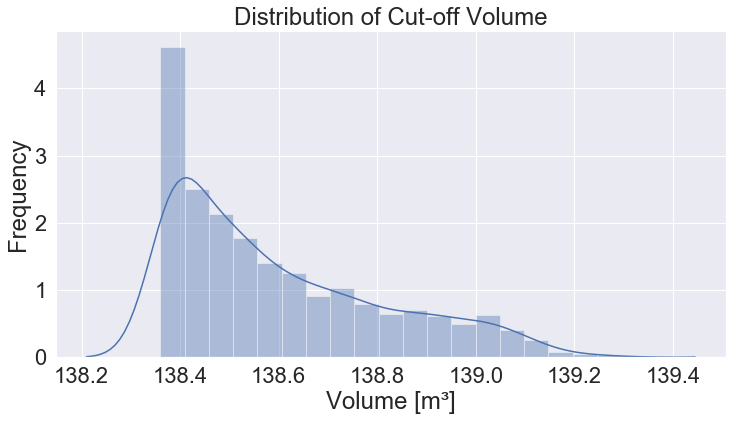

In [59]:
plt.figure(figsize=(12,6))
sns.distplot(df_ART_flow['Cutoff_Volume'])
plt.xlabel('Volume [m³]')
plt.ylabel('Frequency')
plt.title('Distribution of Cut-off Volume');

In [60]:
# Calculate ART for each parcel in hours
df_ART_flow['ART_flow'] = round((df_ART_flow['Arrival'] - df_ART_flow['Departure']).astype('timedelta64[m]')/60,2)
df_ART_flow.head()

,Departure,Arrival,Cutoff_Volume,ART_flow
0,2020-01-06 00:48:00,2020-01-06 19:45:00,138.602833,18.95
1,2020-01-06 01:59:00,2020-01-06 20:14:00,138.769167,18.25
2,2020-01-06 02:16:00,2020-01-06 20:15:00,138.838167,17.98
3,2020-01-06 04:07:00,2020-01-06 20:48:00,138.680000,16.68
4,2020-01-06 05:20:00,2020-01-06 21:08:00,138.368333,15.80


In [61]:
df_ART_flow.describe()

,Cutoff_Volume,ART_flow
count,1917.000000,1917.000000
mean,138.598190,17.251309
std,0.214479,4.356311
min,138.360000,0.120000
25%,138.416833,15.320000
50%,138.530500,17.430000
75%,138.731000,18.750000
max,139.295167,45.050000


In [62]:
# Departure and arrival curve
test = df_ART_flow.set_index('Arrival').loc['2020-1-26']

test['Departure'] == test['Departure'].apply(lambda x: x.time())


fig = make_subplots()

fig.add_trace(go.Scatter(
    x=test.index,
    y=test['Departure'],
    mode='lines+markers',
    name='Residence time: 11 - 17 hours', marker=dict(
        size=0.5)
), secondary_y = False)

art_long = test[test['ART_flow'] >= 17.9]

fig.add_trace(go.Scatter(
    x=art_long.index,
    y=art_long['Departure'],
    mode='lines+markers',
    name='Residence time: 18 - 20 hours', marker=dict(
        size=0.5)
), secondary_y = False)



# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

fig.update_yaxes(title_text="Departure from Monkebüde wet-well")
fig.update_xaxes(title_text="Arrival at end of pipe")

fig.show()




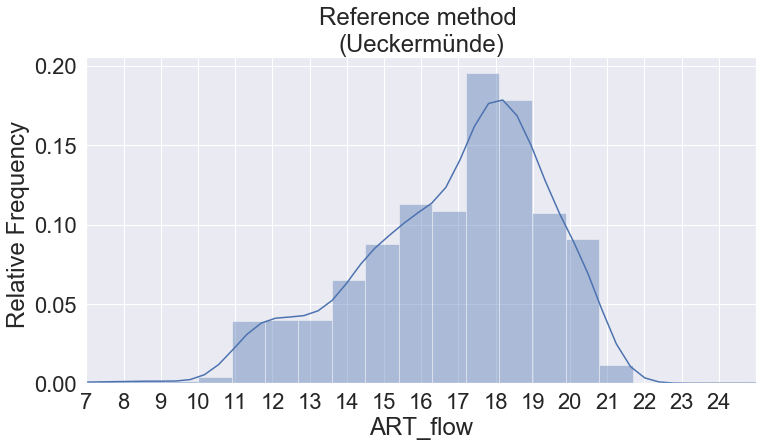

In [63]:
plt.figure(figsize=(12,6))
sns.distplot(df_ART_flow['ART_flow'])

plt.ylabel('Relative Frequency ')
plt.title('Reference method \n(Ueckermünde)')


plt.xticks(np.arange(7,25))
plt.xlim(7,25);

ax.set_xlabel('Retention Time [h]',fontsize=18);
ax.set_ylabel('Relative Frequency',fontsize=18);
sns.set(font_scale = 2)
plt.show()


In [64]:
df_ART_flow.describe()

,Cutoff_Volume,ART_flow
count,1917.000000,1917.000000
mean,138.598190,17.251309
std,0.214479,4.356311
min,138.360000,0.120000
25%,138.416833,15.320000
50%,138.530500,17.430000
75%,138.731000,18.750000
max,139.295167,45.050000


In [65]:
# Outliers and extreme values
df_ART_flow[(df_ART_flow['ART_flow'] > 40) | 
            (df_ART_flow['ART_flow'] < 1)].head()

,Departure,Arrival,Cutoff_Volume,ART_flow
578,2020-01-19 19:01:00,2020-01-21 13:35:00,138.721500,42.57
579,2020-01-19 19:28:00,2020-01-21 13:58:00,138.461833,42.50
580,2020-01-19 19:57:00,2020-01-21 14:36:00,138.899000,42.65
581,2020-01-19 20:16:00,2020-01-21 15:18:00,138.822667,43.03
582,2020-01-19 20:43:00,2020-01-21 16:07:00,138.414667,43.40


#### All the above dates are where flow meter data is missing. These should be removed from dataset

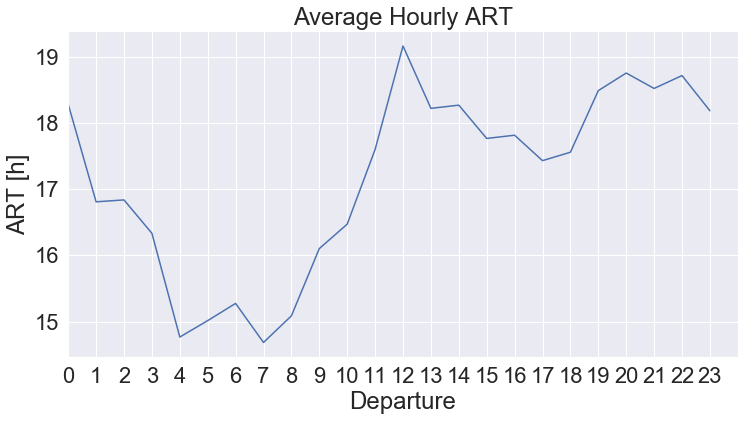

In [66]:
# Plot avg. daily ART - Departure 
daily_ART_flow = df_ART_flow.set_index('Departure')
daily_ART_flow = daily_ART_flow.groupby(daily_ART_flow.index.hour).mean()

plt.figure(figsize=(12,6))
sns.lineplot(x = daily_ART_flow.index, y = daily_ART_flow['ART_flow']);

plt.xlabel('Departure')
plt.ylabel('ART [h]')
plt.title('Average Hourly ART');


plt.xticks(np.arange(0,24))
plt.xlim(0,24);

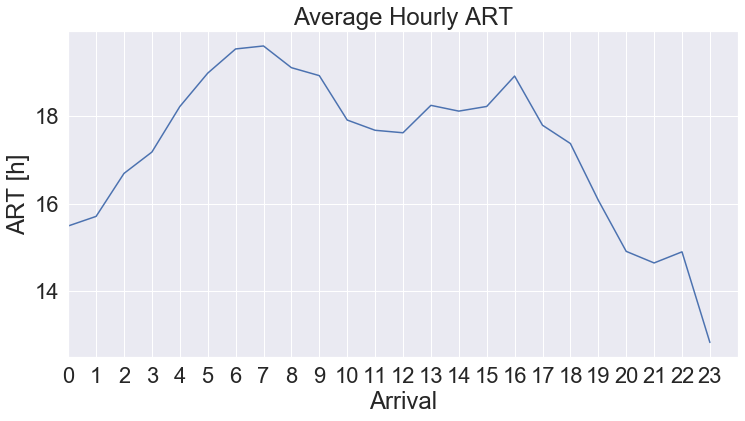

In [67]:
# Plot avg. daily ART - Arrival 
daily_ART_flow = df_ART_flow.set_index('Arrival')
daily_ART_flow = daily_ART_flow.groupby(daily_ART_flow.index.hour).mean()

plt.figure(figsize=(12,6))
sns.lineplot(x = daily_ART_flow.index, y = daily_ART_flow['ART_flow'])

plt.xlabel('Arrival')
plt.ylabel('ART [h]')
plt.title('Average Hourly ART');

plt.xticks(np.arange(0,24))
plt.xlim(0,24);

## 3.2 Temperature Data

In [68]:
df_pump_temp

,Pump_Start,Pump_Stop
2020-01-06 00:00:00,0,0
2020-01-06 00:01:00,0,0
2020-01-06 00:02:00,0,0
2020-01-06 00:03:00,0,0
2020-01-06 00:04:00,0,0
...,...,...
2020-02-18 23:55:00,0,0
2020-02-18 23:56:00,0,0
2020-02-18 23:57:00,0,0
2020-02-18 23:58:00,0,0


In [69]:
# Get avg. Daily flow from flow data
def daily_volume (data):
    day = []
    flow = []
    
    for date in data.index.map(lambda t: t.date()).unique():
        count = 0
        for i in data[data.index.date == date]['Flow_Rate']:
            count += i * 1/60
        day.append(date)
        flow.append(count)
    return round(np.array(flow).mean(),2)

In [70]:
daily_volume(df_flow.dropna())

188.41

In [71]:
#Calculate the number of pump starts it would requier for a parcel to exit the pipe
#avg. daily flow [m³/day]
daily_flow = daily_volume(df_flow.dropna())

#avg. number of pump starts per day
pump_starts = round(pump_freq_T['Pump_Start'].mean(),0)

#parcel volume per pump event
discharge_volume = round((daily_flow/pump_starts),2)

#pipe volume in m³
v = round(3.14*4886*(0.095**2),2)

print(f'Average Daily Flow = {daily_flow}\nPump Events per day = {pump_starts} m³/day\nParcel Volume = {discharge_volume} m³')

Average Daily Flow = 188.41
Pump Events per day = 48.0 m³/day
Parcel Volume = 3.93 m³


In [72]:
def residence_time(data, q, v):
        import math
        
        departure = []
        arrival = []
        art = []
        for i in range(len(data.index.values)):
            start = data.iloc[i].name
            departure.append(start)

            # number of daily pumping events
            d = pump_starts #df_pump_day.loc[start.date()].values[0]
            
            # parcel size
            a = round((q/d),2) 
            
            # number of pumpevents till discharge
            j = round(v/a,0) 
            
            
            if (i+int(j)) in range(len(data.index.values)):
                        
                stop = data.iloc[i+int(j)].name#+ np.array(freq[:-2]).mean()*(math.modf(j)[0]) ##mean time between pumps
                arrival.append(stop)
                art.append((stop-start))
            
            else:
                break


        if len(departure) > len(arrival):

            d = {'Departure': departure[:len(arrival)],'Arrival':arrival,'ART_temp':art}

        elif len(departure) < len(arrival):  

            d = {'Departure': departure,'Arrival':arrival[len(departure)],'ART_temp':art}

        else:
            d = {'Departure': departure,'Arrival':arrival,'ART_temp':art}

        return pd.DataFrame(data = d)

In [73]:
df_new = pd.DataFrame(data = df_pump_temp[df_pump_temp['Pump_Start'] == 1]['Pump_Start'].values,
                          index = df_pump_temp[df_pump_temp['Pump_Start'] == 1].index, columns= ['Pump_Start'] )

df_ART_temp = residence_time(df_new,daily_flow,v)
df_ART_temp['ART_temp'] = round(df_ART_temp['ART_temp'].astype('timedelta64[m]')/60,2)
df_ART_temp


,Departure,Arrival,ART_temp
0,2020-01-06 00:32:00,2020-01-06 19:34:00,19.03
1,2020-01-06 01:44:00,2020-01-06 19:51:00,18.12
2,2020-01-06 02:17:00,2020-01-06 20:13:00,17.93
3,2020-01-06 03:26:00,2020-01-06 20:35:00,17.15
4,2020-01-06 04:07:00,2020-01-06 21:22:00,17.25
...,...,...,...
2091,2020-02-18 07:34:00,2020-02-18 21:54:00,14.33
2092,2020-02-18 08:11:00,2020-02-18 22:39:00,14.47
2093,2020-02-18 08:39:00,2020-02-18 23:01:00,14.37
2094,2020-02-18 09:12:00,2020-02-18 23:11:00,13.98


In [74]:
df_ART_temp.describe()

,ART_temp
count,2096.000000
mean,17.334571
std,1.638984
min,12.830000
25%,16.150000
50%,17.410000
75%,18.480000
max,21.630000


In [75]:
# Departure and arrival curve
test_t = df_ART_temp.set_index('Arrival').loc['2020-1-8']

test_t['Departure'] == test_t['Departure'].apply(lambda x: x.time())


fig = make_subplots()

fig.add_trace(go.Scatter(
    x=test_t.index,
    y=test_t['Departure'],
    mode='lines+markers',
    name='Residence time: 11 - 17 hours', marker=dict(
        size=0.5)
), secondary_y = False)

art_long_t = test_t[test_t['ART_temp'] >= 18]

fig.add_trace(go.Scatter(
    x=art_long_t.index,
    y=art_long_t['Departure'],
    mode='lines+markers',
    name='Residence time: 18 - 20 hours', marker=dict(
        size=0.5)
), secondary_y = False)



# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

# Set x-axis title
#fig.update_xaxes(title_text="Time [minutes]")

# Set y-axes titles
#fig.update_xaxes(tickangle=90,
                 #tickmode = 'array',
                 #tickvals = test.index,
                 #ticktext= [d.strftime('%H:%M:%S') for d in test.index])

fig.update_yaxes(title_text="Departure from Monkebüde wet-well")
fig.update_xaxes(title_text="Arrival at end of pipe")

#fig.update_xaxes(nticks=9,tickangle = 0)
fig.update_yaxes(nticks=9, tickangle = 0)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.update_yaxes(tickfont=dict(size=18))
fig.update_xaxes(tickfont=dict(size=18))

fig.show()


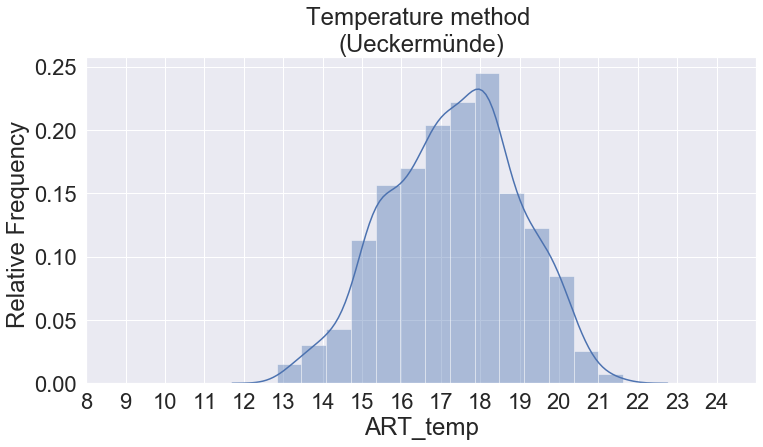

In [76]:
plt.figure(figsize=(12,6))
sns.distplot(df_ART_temp['ART_temp'], bins = 14)

plt.ylabel('Relative Frequency ')
plt.title('Temperature method \n(Ueckermünde)')


plt.xticks(np.arange(8,25))
plt.xlim(8,25);

ax.set_xlabel('Retention Time [h]',fontsize=18);
ax.set_ylabel('Relative Frequency',fontsize=18);
sns.set(font_scale = 2)
plt.show()


In [77]:
df_ART_temp.describe()

,ART_temp
count,2096.000000
mean,17.334571
std,1.638984
min,12.830000
25%,16.150000
50%,17.410000
75%,18.480000
max,21.630000


In [78]:
# Outliers and extreme values
df_ART_temp[(df_ART_temp['ART_temp'] > 30) | 
            (df_ART_temp['ART_temp'] < 1)]

,Departure,Arrival,ART_temp


There were no missing values in temperature data. Results are more consistant and have no clear outliers

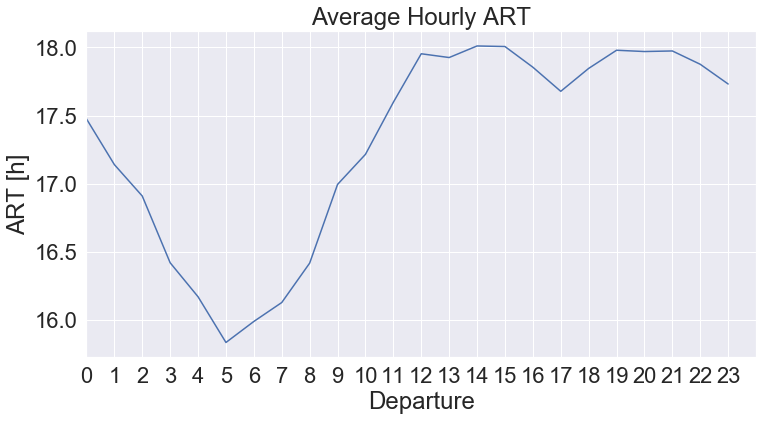

In [79]:
# Plot avg. daily ART - Departure 
daily_ART_temp = df_ART_temp.set_index('Departure')
daily_ART_temp = daily_ART_temp.groupby(daily_ART_temp.index.hour).mean()

plt.figure(figsize=(12,6))
sns.lineplot(x = daily_ART_temp.index, y = daily_ART_temp['ART_temp']);

plt.xlabel('Departure')
plt.ylabel('ART [h]')
plt.title('Average Hourly ART');


plt.xticks(np.arange(0,24))
plt.xlim(0,24);

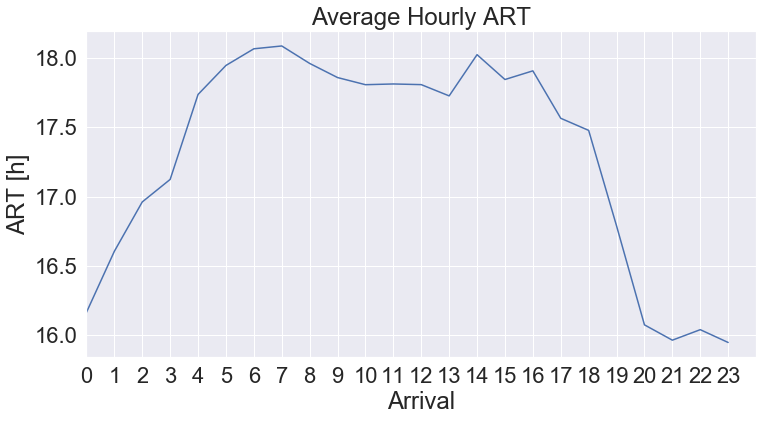

In [80]:
# Plot avg. daily ART - Departure 
daily_ART_temp = df_ART_temp.set_index('Arrival')
daily_ART_temp = daily_ART_temp.groupby(daily_ART_temp.index.hour).mean()

plt.figure(figsize=(12,6))
sns.lineplot(x = daily_ART_temp.index, y = daily_ART_temp['ART_temp']);

plt.xlabel('Arrival')
plt.ylabel('ART [h]')
plt.title('Average Hourly ART');


plt.xticks(np.arange(0,24))
plt.xlim(0,24);

## Chapter 4 - Comparing Results

## 4.1 Departure ART

In [81]:
# create one dataframe with art flow & art temp


# set arrival as index
df_ART_temp_de = df_ART_temp.set_index('Departure')
df_ART_flow_de = df_ART_flow.set_index('Departure')

# Removing duplicate index values 
#df_ART_temp_de = df_ART_temp_de[~df_ART_temp_de.index.duplicated(keep='first')]
df_ART_flow_de = df_ART_flow_de[~df_ART_flow_de.index.duplicated(keep='first')]


# join datasets 
art_data = pd.concat([df_ART_flow_de,
                      df_ART_temp_de], axis = 1)

art_data.drop(['Arrival', 'Cutoff_Volume', 'Arrival'], axis =1, inplace = True)


# Resample every hour per day
df_grouped_de = art_data.groupby([art_data.index.date, art_data.index.hour]).mean()
df_grouped_de.rename_axis(index=['Date', 'Time'], inplace = True)

#check for null values
df_grouped_de.dropna(inplace = True)

df_grouped_de.head()

ART_flow  ART_temp
Date       Time                    
2020-01-06 0        18.95    19.030
           1        18.25    18.120
           2        17.98    17.930
           4        16.68    17.250
           5        15.80    16.415

In [82]:
#convert index to date time - this makes it easier to plot
departure_art = df_grouped_de.reset_index()
departure_art['Date']= departure_art['Date'].apply(lambda x: str(x))
departure_art['Time']= departure_art['Time'].apply(lambda x: str(x)+ ':00:00')
departure_art.index = pd.to_datetime(departure_art['Date'] + ' ' + departure_art['Time'])
departure_art.drop(['Date','Time'], axis = 1, inplace = True)

In [83]:
#Drop dates where pumping duration was > 10 minutes
df_new_de = departure_art[(departure_art.index.date != datetime(2020,1,19).date())
                       & (departure_art.index.date != datetime(2020,1,20).date())]

In [84]:
fig = make_subplots()
#df_new_de.index = df_new_de.index.strftime("%Y-%m-%d %H")

fig.add_trace(go.Scatter(
    x=df_new_de.index.map(str),
    y=df_new_de['ART_flow'].values,
    mode='lines+markers',
    name='ART-flow', marker=dict(
        size=0.5)
), secondary_y = False)


fig.add_trace(go.Scatter(
    x=df_new_de.index.map(str),
    y=df_new_de['ART_temp'].values,
    mode='lines+markers',
    name='ART-temp', marker=dict(
        size=0.5)
), secondary_y = False)
             

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


# Set y-axes titles


fig.update_yaxes(title_text="ART [h]")
fig.update_xaxes(title_text="Departure time")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))


fig.show()

In [85]:
residuals = df_new_de['ART_temp']-df_new_de['ART_flow']
mspe = round(np.mean(abs(residuals/df_new_de['ART_flow'])),2)*100
print(f'The root mean precent error is: \n{(mspe)}%')

The root mean precent error is: 
10.0%


In [86]:
#RMSE in %
y_true = df_new_de['ART_flow']
y_pred = df_new_de['ART_temp']

rmspe = (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))) * 100

print(f'The root mean squared precent error is: \n{round((rmspe),2)}%')

The root mean squared precent error is: 
13.67%


In [87]:
avg_departure_art_new = df_new_de.groupby(df_new_de.index.hour).mean()


fig = make_subplots()

fig.add_trace(go.Scatter(
    x=avg_departure_art_new.index,
    y=avg_departure_art_new['ART_flow'],
    mode='lines+markers',
    name='ART-flow', marker=dict(
        size=0.5)
), secondary_y = False)


fig.add_trace(go.Scatter(
    x=avg_departure_art_new.index,
    y=avg_departure_art_new['ART_temp'],
    mode='lines+markers',
    name='ART-temp', marker=dict(
        size=0.5)
), secondary_y = False)
             

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


fig.update_yaxes(title_text="ART [h]")
fig.update_xaxes(title_text="Departure time")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.show()

In [88]:
residuals =df_new_de.groupby(df_new_de.index.hour).mean()['ART_temp']-df_new_de.groupby(df_new_de.index.hour).mean()['ART_flow']
mspe = round(np.mean(abs(residuals/df_new_de.groupby(df_new_de.index.hour).mean()['ART_flow'])),2)*100
print(f'The root mean precent error is: \n{(mspe)}%')

The root mean precent error is: 
4.0%


In [89]:
# RMSE in hours
from sklearn import metrics
print('RMSE:', np.sqrt(metrics.mean_squared_error(df_new_de.groupby(df_new_de.index.hour).mean()['ART_flow'],
                                                  df_new_de.groupby(df_new_de.index.hour).mean()['ART_temp'])))

RMSE: 0.9045815900076677


In [90]:
#RMSE in %
y_true = df_new_de.groupby(df_new_de.index.hour).mean()['ART_flow']
y_pred = df_new_de.groupby(df_new_de.index.hour).mean()['ART_temp']

rmspe = (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))) * 100

print(f'The root mean squared precent error is: \n{round((rmspe),2)}%')

The root mean squared precent error is: 
6.08%


## 4.1 Arrival ART

In [91]:
# create one dataframe with art flow & art temp


# set arrival as index
df_ART_temp_ar = df_ART_temp.set_index('Arrival')
df_ART_flow_ar = df_ART_flow.set_index('Arrival')

# Removing duplicate index values 
df_ART_temp_ar = df_ART_temp_ar[~df_ART_temp_ar.index.duplicated(keep='first')]
df_ART_flow_ar = df_ART_flow_ar[~df_ART_flow_ar.index.duplicated(keep='first')]

art_data = pd.concat([df_ART_temp_ar, df_ART_flow_ar], axis = 1)
art_data.drop(['Departure', 'Cutoff_Volume', 'Departure'], axis =1, inplace = True)


# Resample every hour per day
df_grouped_ar = art_data.groupby([art_data.index.date, art_data.index.hour]).mean()
df_grouped_ar.rename_axis(index=['Date', 'Time'], inplace = True)

#check for null values
df_grouped_ar.dropna(inplace = True)

df_grouped_ar.head()

ART_temp   ART_flow
Date       Time                     
2020-01-06 19      18.575  18.950000
           20      17.540  17.636667
           21      16.940  15.725000
           22      16.225  15.320000
           23      16.415  15.975000

In [92]:
#convert index to date time - this makes it easier to plot
arrival_art = df_grouped_ar.reset_index()
arrival_art['Date']= arrival_art['Date'].apply(lambda x: str(x))
arrival_art['Time']= arrival_art['Time'].apply(lambda x: str(x)+ ':00:00')
arrival_art.index = pd.to_datetime(arrival_art['Date'] + ' ' + arrival_art['Time'])
arrival_art.drop(['Date','Time'], axis = 1, inplace = True)

In [93]:
#Drop dates where pumping duration was > 10 minutes
df_new_ar = arrival_art[(arrival_art['ART_flow'].index.date != datetime(2020,1,21).date())
                       & (arrival_art['ART_flow'].index.date != datetime(2020,1,22).date())]



In [94]:
fig = make_subplots()
#df_new_de.index = df_new_de.index.strftime("%Y-%m-%d %H")

fig.add_trace(go.Scatter(
    x=df_new_ar.index.map(str),
    y=df_new_ar['ART_flow'].values,
    mode='lines+markers',
    name='ART-flow', marker=dict(
        size=0.5)
), secondary_y = False)


fig.add_trace(go.Scatter(
    x=df_new_ar.index.map(str),
    y=df_new_ar['ART_temp'].values,
    mode='lines+markers',
    name='ART-temp', marker=dict(
        size=0.5)
), secondary_y = False)
             

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


# Remove plotting gaps caused by removing outliers
fig.update_xaxes(
    rangebreaks=[
        dict(values=["2020-1-21", "2020-1-22"]) 
    ]
)



# Set y-axes titles


fig.update_yaxes(title_text="ART [h]")
fig.update_xaxes(title_text="Arrival time")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=40,tickangle = 45)
fig.update_yaxes(nticks=9, tickangle = 0)


fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))


fig.show()

In [95]:
residuals = df_new_ar['ART_temp']-df_new_ar['ART_flow']
mspe = round(np.mean(abs(residuals/df_new_ar['ART_flow'])),2)*100
print(f'The root mean precent error is: \n{(mspe)}%')

The root mean precent error is: 
10.0%


In [96]:
y_true = df_new_ar['ART_flow']
y_pred = df_new_ar['ART_temp']

rmspe = (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))) * 100

print(f'The root mean squared precent error is: \n{round((rmspe),2)}%')

The root mean squared precent error is: 
14.02%


In [97]:
avg_arrival_art_new = df_new_ar.groupby(df_new_ar.index.hour).mean()

#Change indix to string so that the plotted ticks are in the format '00:00'
avg_arrival_art_new.index = pd.to_datetime(avg_arrival_art_new.index, format= '%H').strftime('%H:%M')

fig = make_subplots()

fig.add_trace(go.Scatter(
    x=avg_arrival_art_new.index,
    y=avg_arrival_art_new['ART_flow'],
    mode='lines+markers',
    name='ART-flow', marker=dict(
        size=0.5)
), secondary_y = False)


fig.add_trace(go.Scatter(
    x=avg_arrival_art_new.index, 
    y=avg_arrival_art_new['ART_temp'],
    mode='lines+markers',
    name='ART-temp', marker=dict(
        size=0.5)
), secondary_y = False)
    
    
# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


fig.update_yaxes(title_text="ART [h]")
fig.update_xaxes(title_text="Arrival time")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=25,tickangle = 45)
fig.update_yaxes(nticks=9, tickangle = 0)


fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))


fig.show()

In [98]:
residuals =avg_arrival_art_new['ART_temp']-avg_arrival_art_new['ART_flow']
mspe = round(np.mean(abs(residuals/avg_arrival_art_new['ART_flow'])),2)*100
print(f'The root mean precent error is: \n{(mspe)}%')

The root mean precent error is: 
4.0%


In [99]:
y_true = avg_arrival_art_new['ART_flow']
y_pred = avg_arrival_art_new['ART_temp']

rmspe = (np.sqrt(np.mean(np.square((y_true - y_pred) / y_true)))) * 100

print(f'The root mean squared precent error is: \n{round((rmspe),2)}%')

The root mean squared precent error is: 
6.18%


In [100]:
# avg ART-arrival with typical pump events
fig = make_subplots(specs=[[{"secondary_y": True}]])

#choose pumping pattern to plot

day = '2020-1-8'

#make dataframe

oneday_pump = df_ART_flow_de.loc[day].drop('ART_flow', axis = 1)
oneday_pump.index = df_ART_flow_de.loc[day].index = pd.to_datetime(oneday_pump.index, format= '%y-%m-%d %H:%M:%S').strftime('%H:%M')

new_df = pd.concat([avg_arrival_art_new,oneday_pump], axis = 1)
new_df.index = pd.to_datetime(new_df.index, format= '%H:%M')
new_df.sort_index(inplace= True)
new_df.index = pd.to_datetime(new_df.index, format= '%y-%m-%d %H:%M:%S')#.strftime('%H:%M')


fig.add_trace(go.Scatter(
    x=new_df[new_df['ART_flow'] >= 0].index,
    y=new_df[new_df['ART_flow'] >= 0]['ART_flow'],
    mode='lines+markers',
    name='ART-flow', marker=dict(
        size=0.5)
), secondary_y = False)
    



    
# Add pumping events


fig.add_trace(go.Scatter(
    x= new_df[new_df['Cutoff_Volume'] > 0].index,
    y=np.ones(len(new_df[new_df['Cutoff_Volume'] > 0].index))*0.5,
    mode='markers',
    name='Pump Event', marker=dict(
        size=10,
        color='red',
        symbol='triangle-up')
),secondary_y = True)
    

# Legend layout
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="top",
    y=1.1,
    xanchor="left",
    x=0.0
))


fig.update_yaxes(tickfont=dict(size=15), title = 'RT [h]')
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=20,tickangle = 45)
fig.update_yaxes(nticks=20, tickangle = 0)

fig.update_yaxes(visible=False, 
                 showticklabels=False, 
                 secondary_y = True)


fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.show()

## 4.3 Arrival / Departure curve of one day

In [101]:
# Departure and arrival curve
test = df_ART_flow.set_index('Arrival').loc['2020-2-7']
test_t = df_ART_temp.set_index('Arrival').loc['2020-2-7']

test['Departure'] == test['Departure'].apply(lambda x: x.time())
test_t['Departure'] == test_t['Departure'].apply(lambda x: x.time())


fig = make_subplots()

fig.add_trace(go.Scatter(
    x=test.index,
    y=test['Departure'],
    mode='lines+markers',
    name='ART_flow', marker=dict(
        size=0.5)
), secondary_y = False)

art_long = test[test['ART_flow'] >= 17.9]


fig.add_trace(go.Scatter(
    x=test_t.index,
    y=test_t['Departure'],
    mode='lines+markers',
    name='ART_temp', marker=dict(
        size=0.5)
), secondary_y = False)

art_long_t = test_t[test_t['ART_temp'] >= 17.9]

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

fig.update_yaxes(title_text="Departure from Monkebüde wet-well")
fig.update_xaxes(title_text="Arrival at end of pipe")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.show()


## 4.4 Pumping events - flow vs. temp

In [153]:
#remove outlier days

pump_freq_new = pump_freq[(pump_freq.index != datetime(2020,1,20).date()) &
                     (pump_freq.index != datetime(2020,1,21).date())]

pump_freq_T_new = pump_freq_T[(pump_freq_T.index != datetime(2020,1,20).date()) &
                     (pump_freq_T.index != datetime(2020,1,21).date())]

fig = go.Figure(data=[
    go.Bar(name='Pump events - actual', x=pump_freq_new.index, y=pump_freq_new['Pump_Start']),
    go.Bar(name='Pump events - temp', x=pump_freq_T_new.index, y=pump_freq_T_new['Pump_Start'])
])


# Remove plotting gaps caused by removing outliers
fig.update_xaxes(
    rangebreaks=[
        dict(values=["2020-1-20", "2020-1-21"]) 
    ]
)

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.72
))

fig.update_yaxes(title_text="Pump events")
fig.update_xaxes(title_text="Day")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=15,tickangle = 0)
fig.update_yaxes(nticks=15, tickangle = 0)

fig.show()

In [103]:
y_true_p = pump_freq_new['Pump_Start']
y_pred_p = pump_freq_T_new['Pump_Start']
rmspe = (np.sqrt(np.mean(np.square((y_true_p - y_pred_p) / y_true_p)))) * 100
print(f'The root mean squared precent error is: \n{round((rmspe),2)}%')

The root mean squared precent error is: 
15.66%


In [104]:
(y_true_p-y_pred_p).mean()

-3.9285714285714284

### Distribution of pumping events

In [105]:
pump_freq_new.describe()

,Pump_Start
count,42.000000
mean,44.619048
std,5.818190
min,34.000000
25%,40.250000
50%,45.000000
75%,49.000000
max,59.000000


In [106]:
pump_freq_T.describe()

,Pump_Start
count,44.000000
mean,48.431818
std,3.931966
min,40.000000
25%,46.000000
50%,48.000000
75%,52.000000
max,57.000000


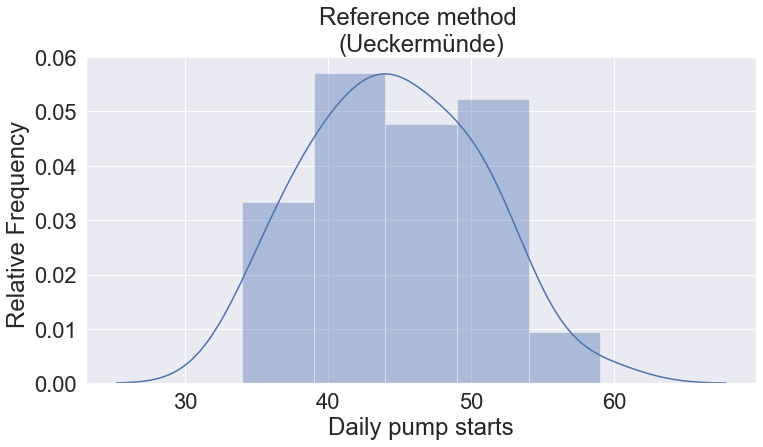

In [107]:
plt.figure(figsize=(12,6))
sns.distplot(pump_freq_new['Pump_Start'], bins = 5)

plt.ylabel('Relative Frequency ')
plt.title('Reference method \n(Ueckermünde)')


#plt.xticks(np.arange(8,25))
#plt.xlim(8,25);

plt.xlabel('Daily pump starts');
sns.set(font_scale = 2)
plt.show()


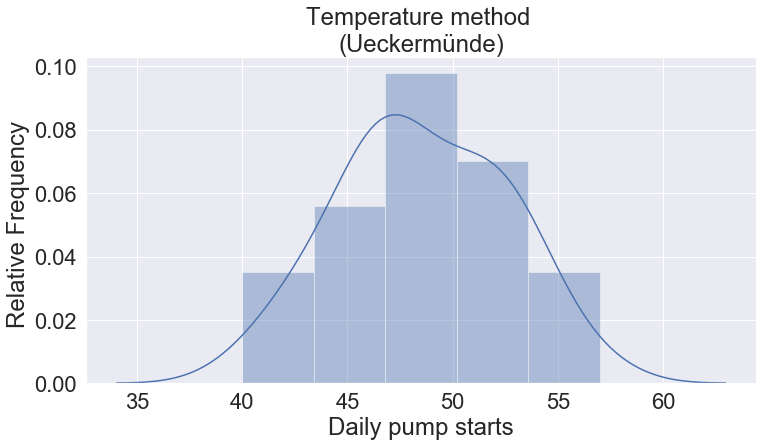

In [108]:
plt.figure(figsize=(12,6))
sns.distplot(pump_freq_T_new['Pump_Start'], bins = 5)

plt.ylabel('Relative Frequency ')
plt.title('Temperature method \n(Ueckermünde)')


#plt.xticks(np.arange(8,25))
#plt.xlim(8,25);

plt.xlabel('Daily pump starts');
sns.set(font_scale = 2)
plt.show()

## Chapter 5 - Probability & Statistical Analysis

## 5.1 Probability analysis

Here i will test the probability of a change in temperature occuring given that a pumping event already occured

In [109]:
# Remove known outliers found during EDA

pump_flow = pump_start[(pump_start.index.date != datetime(2020,1,20).date())
                       & (pump_start.index.date != datetime(2020,1,21).date())]

pump_temp = df_pump_temp[(df_pump_temp.index.date != datetime(2020,1,20).date())
                       & (df_pump_temp.index.date != datetime(2020,1,21).date())]

In [110]:
df1 = pump_temp[pump_temp['Pump_Start'] == 1]
df1.drop('Pump_Stop', axis = 1, inplace = True)

df2 = pump_flow[pump_flow['Pump_Start'] == 1]
df2.drop('Flow_Rate', axis = 1, inplace = True)

In [111]:
# array of time stamps of every pumping event
timestamp_pump = df2.index

# array of time stamps of where no pumping event occured
timestamp_NOpump = pump_flow[pump_flow['Pump_Start'] == 0]['Pump_Start'].index

# array of time stamps of every local minima in temperature data
timestamp_peak = df1.index

In [112]:
len(timestamp_peak)

2039

In [113]:
#function to add minutes to a timestamp (datetime.time object)
def addMins(tm, mins):
    fulldate = datetime(tm.year, tm.month, tm.day, tm.hour, tm.minute, tm.second)
    fulldate = fulldate + timedelta(minutes=mins)
    return fulldate


def pump_prob(pump_times, peaks, minutes = 3):
    #Check if peak in temperature occurs within x minutes of pump event or not

    mins = []
    count_list = []
    correct = []
    not_detected = []
    i = 0

    while i in range (len(pump_times)):
        count = False
        window = list(range(-minutes,minutes+1))
        window.sort(key = abs)
        for j in window:

            if addMins(pump_times[i],j )in peaks:
                count = True
                correct.append((pump_times[i],(addMins(pump_times[i],j))))
                # remove time stamp from peaks 
                peaks = peaks.delete(peaks.get_loc(addMins(pump_times[i],j)))
                mins.append(j)

        if count:
            count_list.append('Yes')
        else:
            count_list.append('No')
            not_detected.append(pump_times[i])

            
        i+=1

    print(peaks)
    
    d = {'Correct detection': correct , 'Not detected':not_detected ,'False detection' : peaks}
    #df = pd.DataFrame(data = d)
    dict_df = pd.concat([pd.Series(v, name=k) for k, v in d.items()], axis=1)
    
    return (pd.DataFrame(data = np.array(count_list), columns=['value']), mins, dict_df)

DatetimeIndex(['2020-01-06 00:32:00', '2020-01-06 03:26:00',
               '2020-01-06 06:31:00', '2020-01-06 10:45:00',
               '2020-01-06 13:42:00', '2020-01-06 15:32:00',
               '2020-01-06 17:10:00', '2020-01-06 18:22:00',
               '2020-01-06 21:44:00', '2020-01-06 22:46:00',
               ...
               '2020-02-18 01:53:00', '2020-02-18 03:15:00',
               '2020-02-18 03:50:00', '2020-02-18 04:45:00',
               '2020-02-18 05:27:00', '2020-02-18 11:31:00',
               '2020-02-18 16:36:00', '2020-02-18 16:43:00',
               '2020-02-18 17:32:00', '2020-02-18 21:04:00'],
              dtype='datetime64[ns]', length=346, freq=None)


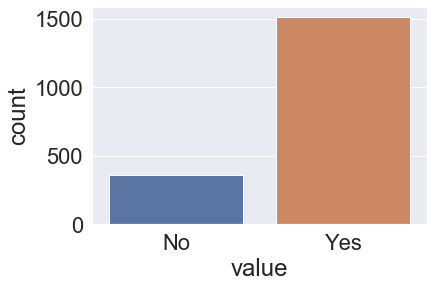

In [114]:
#Detecting minima within x minutes of pumping event
df_prob1, mins, dict_df = pump_prob(timestamp_pump,timestamp_peak,minutes = 15)
sns.countplot(x = 'value', data = df_prob1 );


DatetimeIndex(['2020-01-06 04:07:00', '2020-01-06 07:32:00',
               '2020-01-06 15:01:00', '2020-01-06 16:06:00',
               '2020-01-06 18:42:00', '2020-01-07 00:49:00',
               '2020-01-07 02:56:00', '2020-01-07 04:45:00',
               '2020-01-07 08:21:00', '2020-01-07 14:01:00',
               ...
               '2020-02-18 01:19:00', '2020-02-18 03:31:00',
               '2020-02-18 05:58:00', '2020-02-18 14:52:00',
               '2020-02-18 17:02:00', '2020-02-18 18:48:00',
               '2020-02-18 20:16:00', '2020-02-18 21:54:00',
               '2020-02-18 22:39:00', '2020-02-18 23:11:00'],
              dtype='datetime64[ns]', length=307, freq=None)


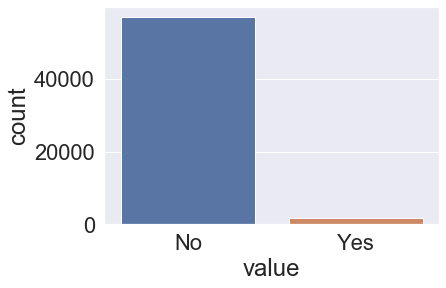

In [115]:
## Detecting minima within x minutes of no pumping event
df_prob2 = pump_prob(timestamp_NOpump,timestamp_peak,minutes = 0)[0]
sns.countplot(x = 'value', data = df_prob2 );

In [116]:
yes = df_prob1['value'].value_counts()['Yes']
no = df_prob1['value'].value_counts()['No']

yes_NoPump = df_prob2['value'].value_counts()['Yes']
no_NoPump = df_prob2['value'].value_counts()['No']

d = {'Minima_temp' : [yes,yes_NoPump], 'No_minima_Temp' : [no,no_NoPump]}
df_prob = pd.DataFrame(data = d, index = ['Pump Event','No Pump Event'])
df_prob['Total'] = df_prob['Minima_temp'] + df_prob['No_minima_Temp']
df_prob

,Minima_temp,No_minima_Temp,Total
Pump Event,1512,362,1874
No Pump Event,1732,56952,58684


### Conditional probability formula

https://www.khanacademy.org/math/statistics-probability/probability-library/conditional-probability-independence/a/conditional-probability-using-two-way-tables


**P(peak ∣ pump) = P(peak and pump)/P( pump)**

In [117]:
p_peakpump = df_prob['Minima_temp'][0]/sum(df_prob['Total'])
p_pump = df_prob['Total'][0] / sum(df_prob['Total'])

prob = p_peakpump/p_pump
print(f'The probability of a peak in temperature occuring given that \na pumping event already occured is: \n\n{round(prob,2)}')

The probability of a peak in temperature occuring given that 
a pumping event already occured is: 

0.81


In [118]:
p_peakpump = df_prob['Minima_temp'][0]/sum(df_prob['Total'])
p_Nopump = df_prob['Total'][1] / sum(df_prob['Total'])

prob = p_peakpump/p_Nopump
print(f'The probability of a peak in temperature occuring given that \na pumping event did not occur is: \n\n{round(prob,2)}')

The probability of a peak in temperature occuring given that 
a pumping event did not occur is: 

0.03


In [119]:
#Plot of temperature and flow rate 

fig = make_subplots(specs=[[{"secondary_y": True}]])

#Choose days to plot

start = '2020-2-16'
stop = '2020-2-16'

fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx[f'EWMA{best_fit[0]}'][start:stop],
    mode='lines+markers',
    name='Temperature [°C]', marker=dict(
        size=0.1, color = 'orange')
),secondary_y=True)



# Add traces
fig.add_trace(go.Scatter(x=data[start:stop].index, 
               y=data[start:stop]['Q'], 
               name="Flow Rate [m³/h]", marker=dict(
        color='blue')),secondary_y=False)

fig.add_trace(go.Scatter(
    x=fx[start:stop].index,
    y=fx['Minima'][start:stop],
    mode='markers',
    marker=dict(
        size=10,
        color='red',
        symbol='cross'
    ),
    name='Detected minima'
), secondary_y = True)


# Legend layout
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="top",
    y=1.1,
    xanchor="left",
    x=0.0
))


# Set y-axes titles
fig.update_yaxes(title_text="Temperature [°C]", secondary_y=True)
fig.update_yaxes(title_text="Flow Rate [m³/h]", secondary_y=False)

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.show()

## 5.2 t- Test


**Departure ART**

In [120]:
df_grouped_de

ART_flow   ART_temp
Date       Time                      
2020-01-06 0     18.950000  19.030000
           1     18.250000  18.120000
           2     17.980000  17.930000
           4     16.680000  17.250000
           5     15.800000  16.415000
...                    ...        ...
2020-02-18 5     15.885000  14.836667
           6     15.450000  14.680000
           7     15.797500  14.330000
           8     15.463333  14.420000
           9     14.392500  14.075000

[968 rows x 2 columns]

In [121]:
df_grouped_ar.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 932 entries, (datetime.date(2020, 1, 6), 19) to (datetime.date(2020, 2, 18), 23)
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   ART_temp  932 non-null    float64
 1   ART_flow  932 non-null    float64
dtypes: float64(2)
memory usage: 17.0 KB


In [122]:
df_grouped_de.info()

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 968 entries, (datetime.date(2020, 1, 6), 0) to (datetime.date(2020, 2, 18), 9)
Data columns (total 2 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   ART_flow  968 non-null    float64
 1   ART_temp  968 non-null    float64
dtypes: float64(2)
memory usage: 17.7 KB


## Sample size and significance

Both arrival and departure ART data sets have more tha 900 values. This is considered a large sample size which could lead to a type I* error in the t-test (Statistics in plain english, page 68).

To avoid this, a random sample of size n = 200 from the ART_flow and ART_temp coulmns will be drawn and the t test will  be preformed on these random samples.

*A type I error (false-positive) occurs if an investigator rejects a null hypothesis that is actually true in the population; a type II error (false-negative) occurs if the investigator fails to reject a null hypothesis that is actually false in the population.

In [123]:
from scipy import stats
import random

#columns to compare
a = df_new_de['ART_flow'].values
b = df_new_de['ART_temp'].values

random.seed(4)
a = random.sample(list(df_new_de['ART_flow'].values), 200)
b = random.sample(list(df_new_de['ART_temp'].values), 200)


# Perform t-test and print result
t_result=stats.ttest_ind(a,b)
print(t_result)

# Test significance
alpha= 0.05
if (t_result[1] < alpha):
    print("A and B are different")
else:
    print("No significant difference found")

Ttest_indResult(statistic=-0.1586131688135725, pvalue=0.8740541027062801)
No significant difference found


**Arrival ART**

In [124]:
from scipy import stats

#columns to compare
a = df_new_ar['ART_flow'].values
b = df_new_ar['ART_temp'].values

random.seed(4)
a = random.sample(list(df_new_ar['ART_flow'].values), 200)
b = random.sample(list(df_new_ar['ART_temp'].values), 200)

# Perform t-test and print result
t_result=stats.ttest_ind(a,b)
print(t_result)

# Test significance
alpha= 0.05
if (t_result[1] < alpha):
    print("A and B are different")
else:
    print("No significant difference found")

Ttest_indResult(statistic=-1.6814159433434455, pvalue=0.0934666176816444)
No significant difference found


###### 5.3 Regression Analysis


In [125]:
import statsmodels.api as sm

**Departure ART**

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               ART_flow   R-squared:                       0.949
Model:                            OLS   Adj. R-squared:                  0.947
Method:                 Least Squares   F-statistic:                     390.8
Date:                Wed, 04 Nov 2020   Prob (F-statistic):           4.73e-15
Time:                        17:24:01   Log-Likelihood:                -21.921
No. Observations:                  23   AIC:                             47.84
Df Residuals:                      21   BIC:                             50.11
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -6.9233      1.197     -5.785      0.000      -9.412      -4.435
ART_temp       1.4139      0.072     19.768      0.000       1.265       1.563
==============================================================================
Omnibus:                        0.623   Durbin-Watson:                   0.421
Prob(Omnibus):                  0.732   Jarque-Bera (JB):                0.678
Skew:                          -0.195   Prob(JB):                        0.713
Kurtosis:                       2.255   Cond. No.                         147.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

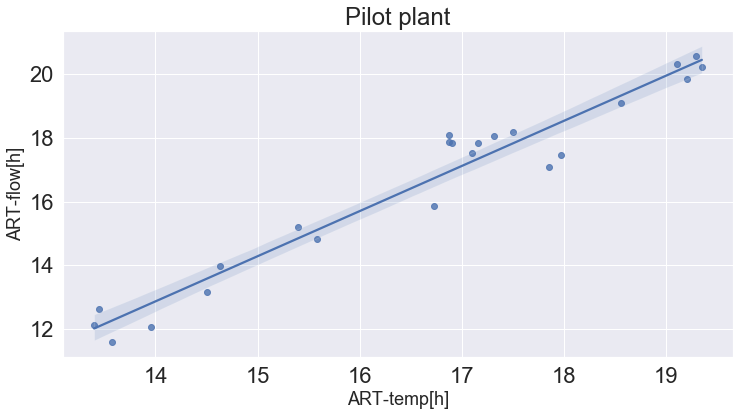

In [126]:
y = df_new_de.loc['2020-1-26': '2020-1-26']['ART_flow'] #target
x1 = df_new_de.loc['2020-1-26': '2020-1-26']['ART_temp'] # feature

plt.figure(figsize=(12,6))
sns.regplot(x = 'ART_temp', y = 'ART_flow',data = df_new_de.loc['2020-1-26'])

plt.title('Pilot plant')

plt.xlabel('ART-temp[h]',fontsize=18)
plt.ylabel('ART-flow[h]',fontsize=18)
sns.set(font_scale = 2)

x = sm.add_constant(x1)
results = sm.OLS(y,x).fit()
results.summary()

**Arrival ART**

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               ART_flow   R-squared:                       0.949
Model:                            OLS   Adj. R-squared:                  0.947
Method:                 Least Squares   F-statistic:                     373.6
Date:                Wed, 04 Nov 2020   Prob (F-statistic):           2.07e-14
Time:                        17:24:01   Log-Likelihood:                -19.359
No. Observations:                  22   AIC:                             42.72
Df Residuals:                      20   BIC:                             44.90
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.7667      1.003     -2.760      0.012      -4.858      -0.675
ART_temp       1.0712      0.055     19.329      0.000       0.956       1.187
==============================================================================
Omnibus:                        3.275   Durbin-Watson:                   0.633
Prob(Omnibus):                  0.194   Jarque-Bera (JB):                2.064
Skew:                          -0.747   Prob(JB):                        0.356
Kurtosis:                       3.140   Cond. No.                         139.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

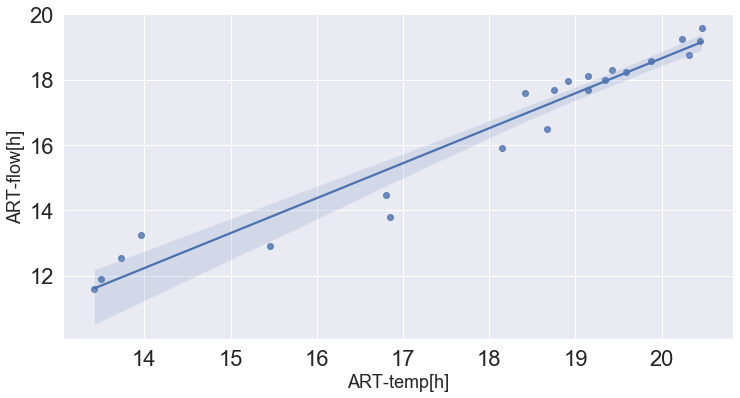

In [127]:
date1 = '2020-1-26'
date2 = '2020-1-26'
y = df_new_ar.loc[date1: date2]['ART_flow'] #target
x1 = df_new_ar.loc[date1: date2]['ART_temp'] # feature

plt.figure(figsize=(12,6))
sns.regplot(x = 'ART_temp', y = 'ART_flow',data = df_new_ar.loc[date1: date2])

plt.xlabel('ART-temp[h]',fontsize=18)
plt.ylabel('ART-flow[h]',fontsize=18)
sns.set(font_scale = 2)

x = sm.add_constant(x1)
results = sm.OLS(y,x).fit()
results.summary()

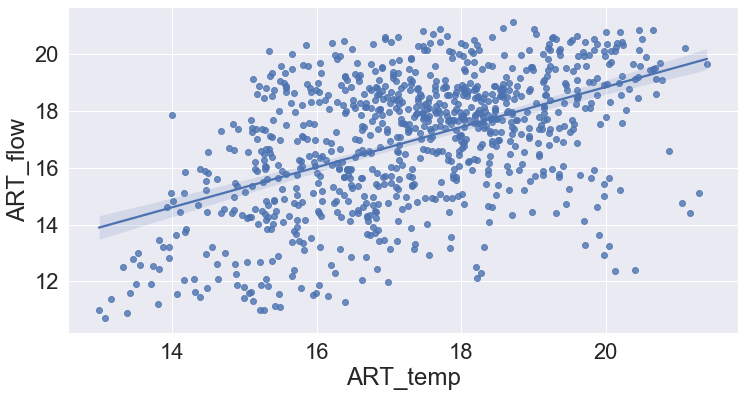

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               ART_flow   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.251
Method:                 Least Squares   F-statistic:                     302.1
Date:                Wed, 04 Nov 2020   Prob (F-statistic):           1.53e-58
Time:                        17:24:02   Log-Likelihood:                -1900.1
No. Observations:                 899   AIC:                             3804.
Df Residuals:                     897   BIC:                             3814.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          4.7267      0.707      6.682      0.000       3.338       6.115
ART_temp       0.7062      0.041     17.381      0.000       0.626       0.786
==============================================================================
Omnibus:                       23.853   Durbin-Watson:                   0.110
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.376
Skew:                          -0.410   Prob(JB):                     3.09e-06
Kurtosis:                       2.933   Cond. No.                         185.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [128]:
plt.figure(figsize=(12,6))
sns.regplot(x = 'ART_temp',
           y = 'ART_flow',
           data = df_new_ar)
plt.show();

y = df_new_ar['ART_flow'] #target
x1 = df_new_ar['ART_temp'] # feature
x = sm.add_constant(x1)
results = sm.OLS(y,x).fit()
results.summary()

In [129]:
d1 = df_ART_flow_ar.resample(rule='40min', closed='left', label='left', base=0).mean().dropna()
d2 = df_ART_temp_ar.resample(rule='40min', closed='left', label='left', base=0).mean().dropna()

art_df_new = pd.concat([d1,d2], axis = 1).dropna()
#avg_h2s_art_df_new['H2S_aq'] = avg_h2s_art_df_new['H2S_aq'].shift(-1)


## only plot daytime
#avg_h2s_art_df_new = avg_h2s_art_df_new[(avg_h2s_art_df_new.index.hour <=6) & 
                                       #(avg_h2s_art_df_new.index.hour >= 0)]

import statsmodels.api as sm
##### Finction to find best day
r2 = []
i = 0
for dates in art_df_new.index:
    
    if dates.date() != i:
        i = dates.date()
        
        y = art_df_new[(art_df_new.index.date == dates.date())]['ART_flow'] 
        x1 = art_df_new[(art_df_new.index.date == dates.date())]['ART_temp']

        if len(y) == len(x1):

            x = sm.add_constant(x1)
            results = sm.OLS(y,x).fit()

            if results.rsquared >= 0.70:# and results.conf_int()[1][1] > 0:
                r2.append((results.rsquared, dates))

i = 0
count = 0
for dates in r2:
    
    if dates[1].date() != i:
        print(dates)
        count +=1
        i = dates[1].date()
print(count)

(0.866448228554095, Timestamp('2020-01-06 19:20:00'))
(0.8092082407778536, Timestamp('2020-01-07 00:40:00'))
(0.7082808675282528, Timestamp('2020-01-09 01:20:00'))
(0.7748556180152653, Timestamp('2020-01-13 00:40:00'))
(0.7009460628326559, Timestamp('2020-01-15 00:40:00'))
(0.7168553362511827, Timestamp('2020-01-16 00:40:00'))
(0.8918325386880906, Timestamp('2020-01-18 00:00:00'))
(0.8270716186349061, Timestamp('2020-01-20 01:20:00'))
(0.8640199760047234, Timestamp('2020-01-21 13:20:00'))
(0.7012514450260885, Timestamp('2020-01-25 00:40:00'))
(0.9579602439648855, Timestamp('2020-01-26 00:40:00'))
(0.7950098586969354, Timestamp('2020-02-02 00:00:00'))
(0.7744635101100064, Timestamp('2020-02-07 01:20:00'))
(0.7680361942345053, Timestamp('2020-02-08 01:20:00'))
(0.7596183157232559, Timestamp('2020-02-09 02:40:00'))
15


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:               ART_flow   R-squared:                       0.750
Model:                            OLS   Adj. R-squared:                  0.746
Method:                 Least Squares   F-statistic:                     168.4
Date:                Wed, 04 Nov 2020   Prob (F-statistic):           1.60e-18
Time:                        17:24:03   Log-Likelihood:                -88.555
No. Observations:                  58   AIC:                             181.1
Df Residuals:                      56   BIC:                             185.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        -11.8495      2.178     -5.440      0.000     -16.213      -7.486
ART_temp       1.6598      0.128     12.978      0.000       1.404       1.916
==============================================================================
Omnibus:                        4.101   Durbin-Watson:                   0.287
Prob(Omnibus):                  0.129   Jarque-Bera (JB):                3.128
Skew:                          -0.444   Prob(JB):                        0.209
Kurtosis:                       3.710   Cond. No.                         250.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

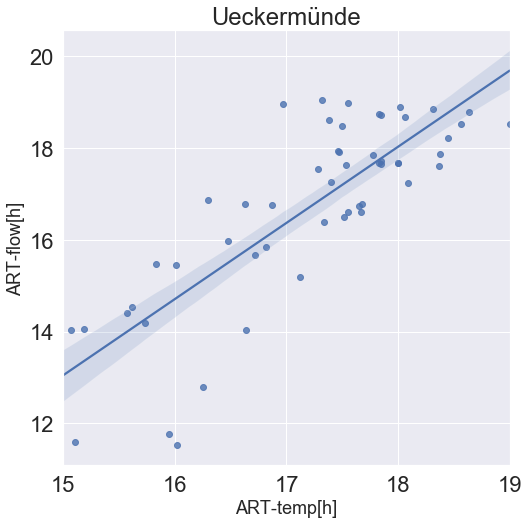

In [130]:
date1 = '2020-02-7'
date2 = '2020-02-8'
y = art_df_new.loc[date1: date2]['ART_flow'] #target
x1 = art_df_new.loc[date1: date2]['ART_temp'] # feature

plt.figure(figsize=(8,8))
sns.regplot(x = 'ART_temp', y = 'ART_flow',data = art_df_new.loc[date1: date2])

plt.title('Ueckermünde')
plt.xticks(np.arange(1,20))
plt.xlim(15,19)

plt.xlabel('ART-temp[h]',fontsize=18)
plt.ylabel('ART-flow[h]',fontsize=18)
sns.set(font_scale = 2)

x = sm.add_constant(x1)
results = sm.OLS(y,x).fit()
results.summary()

## Chapter 6 - Nitrate Dosing Concept

## 6.1 Anoxic retention time

The anoxic retention time is the time a wastewater parcel spends in the pipe section between the Grambin dosing station and the end of the pressure pipe.

To determine this, the ART from the inlet until the dosing station will be subtracted from the ART of the full pipe

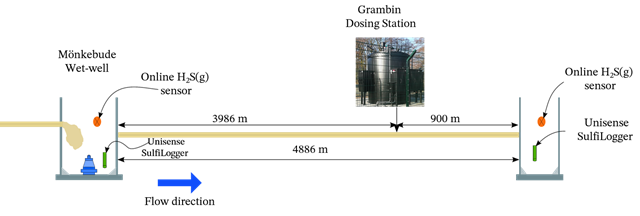

In [131]:
# ART from inlet to dosing pump - length = 3986m

#Calculate the number of pump starts it would requier for a parcel to reach dosing station
#avg. daily flow [m³/day]
daily_flow = daily_volume(df_flow.dropna())

#avg. number of pump starts per day
pump_starts = round(pump_freq_T['Pump_Start'].mean(),0)

#parcel volume per pump event
discharge_volume = round((daily_flow/pump_starts),2)

#pipe volume in m³
v = round(3.14*3986*(0.095**2),2)

print(f'Average Daily Flow = {daily_flow}\nPump Events per day = {pump_starts} m³/day\nParcel Volume = {discharge_volume} m³')


Average Daily Flow = 188.41
Pump Events per day = 48.0 m³/day
Parcel Volume = 3.93 m³


In [132]:
def residence_time2(data, q, v):
        import math
        
        departure = []
        arrival = []
        art = []
        for i in range(len(data.index.values)):
            start = data.iloc[i].name
            departure.append(start)

            # number of daily pumping events
            d = pump_starts #df_pump_day.loc[start.date()].values[0]
            
            #daily flow devided by d
            a = round((q/d),2) 
            
            # number of pumpevents till discharge
            j = round(v/a,0) 
            
            
            if (i+int(j)) in range(len(data.index.values)):
                        
                stop = data.iloc[i+int(j)].name#+ np.array(freq[:-2]).mean()*(math.modf(j)[0]) ##mean time between pumps
                arrival.append(stop)
                art.append((stop-start))
            
            else:
                break



        if len(departure) > len(arrival):

            d = {'Departure': departure[:len(arrival)],'Arrival_Grambin':arrival,'ART_temp_Grambin':art}

        elif len(departure) < len(arrival):  

            d = {'Departure': departure,'Arrival_Grambin':arrival[len(departure)],'ART_temp_Grambin':art}

        else:
            d = {'Departure': departure,'Arrival_Grambin':arrival,'ART_temp_Grambin':art}

        return pd.DataFrame(data = d)

In [133]:
df_new2 = pd.DataFrame(data = df_pump_temp[df_pump_temp['Pump_Start'] == 1]['Pump_Start'].values,
                          index = df_pump_temp[df_pump_temp['Pump_Start'] == 1].index, columns= ['Pump_Start'] )

df_ART_temp2 = residence_time2(df_new2,daily_flow,v)
df_ART_temp2['ART_temp_Grambin'] = round(df_ART_temp2['ART_temp_Grambin'].astype('timedelta64[m]')/60,2)
#df_ART_temp2

In [134]:
# ART of full pressure pipe with outliers removed
test_df = df_ART_temp.set_index('Departure')

In [135]:
df_ART_temp2 = pd.concat([df_ART_temp2.set_index('Departure'), test_df], axis = 1)
df_ART_temp2.dropna(inplace=True)
df_ART_temp2[['Arrival_outlet','ART_temp_outlet']] = df_ART_temp2[['Arrival','ART_temp']]
df_ART_temp2.drop(['Arrival','ART_temp'],axis =1, inplace =True)
df_ART_temp2.dropna(inplace=True)
#df_ART_temp2

In [136]:
# Claculate anoxic retention time
Arrival_Grambin = df_ART_temp2['Arrival_Grambin']
Arrival_end = df_ART_temp2['Arrival_outlet']
ART_anoxic = df_ART_temp2['ART_temp_outlet'] - df_ART_temp2['ART_temp_Grambin']

# Create dataframe with departure-arrival and anoxic RT
d_anoxic = {'Departure_Grambin':Arrival_Grambin, 
            'Arrival': Arrival_end,
           'ART_anoxic':ART_anoxic}

df_ART_anoxic = pd.DataFrame(data = d_anoxic)
#df_ART_anoxic

In [137]:
#Arrival anoxic-RT
ART_anoxic_grouped_ar = df_ART_anoxic.set_index('Arrival').groupby([df_ART_anoxic.set_index('Arrival').index.date,
                                           df_ART_anoxic.set_index('Arrival').index.hour]).mean()

ART_anoxic_grouped_ar.rename_axis(index=['Date', 'Time'], inplace = True)


#Departure anoxic-RT
ART_anoxic_grouped_de = df_ART_anoxic.set_index('Departure_Grambin').groupby([df_ART_anoxic.set_index('Departure_Grambin').index.date,
                                           df_ART_anoxic.set_index('Departure_Grambin').index.hour]).mean()

ART_anoxic_grouped_de.rename_axis(index=['Date', 'Time'], inplace = True)

In [138]:
avg_ART_anoxic_ar = ART_anoxic_grouped_ar.groupby('Time', axis = 0).mean()

avg_ART_anoxic_ar.index = pd.to_datetime(avg_ART_anoxic_ar.index, format= '%H').strftime('%H:%M')


fig = px.line(avg_ART_anoxic_ar,y = avg_ART_anoxic_ar['ART_anoxic'],
              title='',labels={'Time':'Arrival Time (outlet)','ART_anoxic':'ART [h]'})

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=25,tickangle = 45)
fig.update_yaxes(nticks=9, tickangle = 0)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.show()

In [139]:
avg_ART_anoxic_de = ART_anoxic_grouped_de.groupby('Time', axis = 0).mean()

avg_ART_anoxic_de.index = pd.to_datetime(avg_ART_anoxic_de.index, format= '%H').strftime('%H:%M')


fig = px.line(avg_ART_anoxic_de,y = avg_ART_anoxic_de['ART_anoxic'],
              title='',labels={'Time':'Departure Time (Grambin)','ART_anoxic':'ART [h]'})

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))


fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=25,tickangle = 45)
fig.update_yaxes(nticks=9, tickangle = 0)


fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.show()


In [140]:
# plot arrival retention time curve for all sections of the pipe
df_ART_temp2

,Arrival_Grambin,ART_temp_Grambin,Arrival_outlet,ART_temp_outlet
Departure,,,,
2020-01-06 00:32:00,2020-01-06 17:10:00,16.63,2020-01-06 19:34:00,19.03
2020-01-06 01:44:00,2020-01-06 17:38:00,15.90,2020-01-06 19:51:00,18.12
2020-01-06 02:17:00,2020-01-06 18:02:00,15.75,2020-01-06 20:13:00,17.93
2020-01-06 03:26:00,2020-01-06 18:22:00,14.93,2020-01-06 20:35:00,17.15
2020-01-06 04:07:00,2020-01-06 18:42:00,14.58,2020-01-06 21:22:00,17.25
...,...,...,...,...
2020-02-18 07:34:00,2020-02-18 19:43:00,12.15,2020-02-18 21:54:00,14.33
2020-02-18 08:11:00,2020-02-18 20:08:00,11.95,2020-02-18 22:39:00,14.47
2020-02-18 08:39:00,2020-02-18 20:16:00,11.62,2020-02-18 23:01:00,14.37


In [141]:
art_section1_ar = df_ART_temp2.set_index('Arrival_Grambin').drop(['Arrival_outlet','ART_temp_outlet'], axis = 1)
avg_art_section1_ar = art_section1_ar.groupby(art_section1_ar.index.hour).mean()

avg_art_section1_ar.index = pd.to_datetime(avg_art_section1_ar.index, format= '%H').strftime('%H:%M')

## RT curves of any desired day  

In [142]:
fig = make_subplots()


#choose day to plot
day = '2020-1-26'



# Add retention curve of full pipe
fig.add_trace(go.Scatter(
    x=test_df.set_index('Arrival').loc[day].index,
    y=test_df.set_index('Arrival').loc[day]['ART_temp'],
    mode='lines+markers',
    name='RT - EOP', marker=dict(
        size=0.5)
))
    

# Add retention curve till DS
fig.add_trace(go.Scatter(
    x=art_section1_ar.loc[day].index,
    y=art_section1_ar.loc[day]['ART_temp_Grambin'],
    mode='lines+markers',
    name='RT - DS', marker=dict(
        size=0.1, color = 'orange')
))


# Add anaoxic retention curve
fig.add_trace(go.Scatter(
    x=df_ART_anoxic.set_index('Arrival').loc[day].index, 
    y=df_ART_anoxic.set_index('Arrival').loc[day]['ART_anoxic'], 
    name="RT - DS to EOP", marker=dict(
    color='green')
))


# Add pumping events
fig.add_trace(go.Scatter(
    x=test_df.loc[day].index,
    y=np.ones(len(test_df.loc[day].index))*0.5,
    mode='markers',
    name='Pump Event', marker=dict(
        size=10,
        color='red',
        symbol='triangle-up')
))
    

# Legend layout
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="top",
    y=1.1,
    xanchor="left",
    x=0.0
))


fig.update_yaxes(tickfont=dict(size=15), title = 'RT [h]')
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=30,tickangle = 45)
fig.update_yaxes(nticks=20, tickangle = 0)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.show()

## 6.2 Nitrate Dosing Concept

According to the report (Despot, 2020), "The anaerobic residence times of the wastewater slugs entering the dosing point strongly influenced the sulphide buildup in the un-dosed section and are responsible for the sulphide peaks occurring between 04:00 hrs- 08:00 hrs. Moreover, when the residence time in the dosed section exceeded 3 hours, sulphide production resumed and higher H2S(aq) concentrations were detected by the SulfiLoggerTM". 

Based on this and the retention time analysis made from the temperature data, wastewater parcels departing the dosing station between 9pm and 4am are responsible for H2S peaks occuring between 4am and 8am and need to be targeted

In [143]:
d1 = data_h2s.resample(rule='60min', closed='left', label='left', base=0).mean().dropna()
d2 = df_ART_anoxic.set_index('Arrival').resample(rule='60min', closed='left', label='left', base=0).mean().dropna()

h2s_art_df = pd.concat([d1,d2], axis = 1).dropna()

In [144]:
avg_h2s = h2s_art_df[[d.date() not in pd.to_datetime(['2020-1-20','2020-1-11']) for d in h2s_art_df.index]]
avg_h2s = avg_h2s.groupby(avg_h2s.index.time).mean()

avg_h2s.index = pd.to_datetime(avg_h2s.index, format= '%H:%M:%S').strftime('%H:%M')

In [145]:
#Plot of temperature and flow rate 

fig = make_subplots(specs=[[{"secondary_y": True}]])


fig.add_trace(go.Scatter(
    x=avg_h2s.index,
    y=avg_h2s['H2S_aq'],
    mode='lines+markers',
    name='H2S [mg/L]', marker=dict(
        size=0.1, color = 'orange')
),secondary_y=True)


# Add traces
fig.add_trace(go.Scatter(
    x=avg_h2s.index, 
    y=avg_h2s['ART_anoxic'], 
    name="RT - anoxic", marker=dict(
    color='blue')),secondary_y=False)


fig.update_yaxes(tickfont=dict(size=15), title = 'RT [h]', secondary_y=False)
fig.update_yaxes(tickfont=dict(size=15), title = 'H2S [mg/L]', secondary_y=True)

# Legend layout
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.68
))



fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=20,tickangle = 45)
fig.update_yaxes(nticks=10, tickangle = 0)
fig.update_yaxes(nticks=10, tickangle = 0, secondary_y=True)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.show()

## Departure / Arrival Curve of anoxic section

In [146]:
# Departure and arrival curve
## choose day to plot
test = df_ART_anoxic.set_index('Arrival').loc['2020-1-26']


test['Departure_Grambin'] == test['Departure_Grambin'].apply(lambda x: x.time())

fig = make_subplots()

fig.add_trace(go.Scatter(
    x=test.index,
    y=test['Departure_Grambin'],
    mode='lines+markers',
    name='ART_flow', marker=dict(
        size=0.5)
), secondary_y = False)

art_long = test[test['ART_anoxic'] >= 3.7]


fig.add_trace(go.Scatter(
    x=art_long.index,
    y=art_long['Departure_Grambin'],
    mode='lines+markers',
    name='long', marker=dict(
        size=0.5)
), secondary_y = False)



# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.01
))

fig.layout.update(showlegend = False)

fig.update_yaxes(title_text="Departure from Dosing Station")
fig.update_xaxes(title_text="Arrival at EOP")

fig.update_xaxes(nticks=15,tickangle = 45)
fig.update_yaxes(nticks=12, tickangle = 0)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.show()


In [147]:
d1 = data_h2s.resample(rule='40min', closed='left', label='left', base=0).mean().dropna()
d2 = df_ART_anoxic.set_index('Arrival').resample(rule='40min', closed='left', label='left', base=0).mean().dropna()

avg_h2s_art_df_new = pd.concat([d1,d2], axis = 1).dropna()
avg_h2s_art_df_new = avg_h2s_art_df_new[[d.date() not in pd.to_datetime(['2020-1-20','2020-1-21']) for d in avg_h2s_art_df_new.index]]

avg_h2s_art_df_new['parcel_arrival'] = avg_h2s_art_df_new.index.map(lambda x: '04:00 - 08:00' if x.hour in np.arange(4,9) else '09:00 - 03:00')
avg_h2s_art_df_new.dropna(inplace = True)

In [148]:
avg_h2s_art_df_new['bestfit'] = sm.OLS(avg_h2s_art_df_new['H2S_aq'],sm.add_constant(avg_h2s_art_df_new['ART_anoxic'])).fit().fittedvalues

scat1 = avg_h2s_art_df_new[avg_h2s_art_df_new['parcel_arrival'] == '04:00 - 08:00']
scat2 = avg_h2s_art_df_new[avg_h2s_art_df_new['parcel_arrival'] != '04:00 - 08:00']

# Create figure with secondary y-axis
fig = make_subplots()

# Add traces
fig.add_trace(
    go.Scatter(x=scat2['ART_anoxic'].values, y=scat2['H2S_aq'].values,
               mode='markers',
               name="Arrival: 09:00 - 03:00"))

# Add traces
fig.add_trace(
    go.Scatter(x=scat1['ART_anoxic'].values, y=scat1['H2S_aq'].values,
               mode='markers',
               name="Arrival: 04:00 - 08:00"))


fig.add_trace(
    go.Scatter(x = avg_h2s_art_df_new['ART_anoxic'], y=avg_h2s_art_df_new['bestfit'], name="Best-fit line", 
               line = dict(width= 0.9),marker=dict(
        size=50,
        color='black')))

# Add figure title
fig.update_layout(legend=dict(
    yanchor="top",
    y=0.99,
    xanchor="left",
    x=0.75
))


fig.update_xaxes(title_text="RT - Anoxic [h]")
fig.update_yaxes(title_text="H2S [mg/L]")

fig.update_yaxes(tickfont=dict(size=15))
fig.update_xaxes(tickfont=dict(size=15))

fig.update_xaxes(nticks=20,tickangle = 0)
fig.update_yaxes(nticks=20, tickangle = 0)

fig.update_xaxes(title_font=dict(size=18))
fig.update_yaxes(title_font=dict(size=18))

# Legend layout
fig.update_layout(legend=dict(
    orientation="h",
    yanchor="top",
    y=1.1,
    xanchor="left",
    x=0.0
))

fig.show()

In [149]:
d1 = data_h2s.resample(rule='40min', closed='left', label='left', base=0).mean().dropna()
d2 = df_ART_anoxic.set_index('Arrival').resample(rule='40min', closed='left', label='left', base=0).mean().dropna()

avg_h2s_art_df_new = pd.concat([d1,d2], axis = 1).dropna()
#avg_h2s_art_df_new['H2S_aq'] = avg_h2s_art_df_new['H2S_aq'].shift(-1)

avg_h2s_art_df_new['parcel_arrival'] = avg_h2s_art_df_new.index.map(lambda x: '04:00 - 08:00' if x.hour in np.arange(4,9) else '09:00 - 03:00')
avg_h2s_art_df_new.dropna(inplace = True)

## only plot daytime
#avg_h2s_art_df_new = avg_h2s_art_df_new[(avg_h2s_art_df_new.index.hour <=6) & 
                                       #(avg_h2s_art_df_new.index.hour >= 0)]

import statsmodels.api as sm
##### find days with the highest correlation and save in list
r2 = []
i = 0
for dates in avg_h2s_art_df_new.index:
    
    if dates.date() != i:
        i = dates.date()
        
        y = avg_h2s_art_df_new[(avg_h2s_art_df_new.index.date == dates.date())]['H2S_aq'] #target
        x1 = avg_h2s_art_df_new[(avg_h2s_art_df_new.index.date == dates.date())]['ART_anoxic']

        if len(y) == len(x1):

            x = sm.add_constant(x1)
            results = sm.OLS(y,x).fit()

            if results.rsquared >= 0.10:# and results.conf_int()[1][1] > 0:
                r2.append((results.rsquared, dates))

In [150]:
# plot days found in r2

i= 0
for dates in r2:
    
    if dates[1] != i:
        print(dates)
        i = dates[1]

        fig = make_subplots()

        day = dates[1]#datetime(2020, 1,17).date()
        plot2 = avg_h2s_art_df_new[avg_h2s_art_df_new.index.date == day]



        plot2['bestfit'] = sm.OLS(plot2['H2S_aq'],sm.add_constant(plot2['ART_anoxic'])).fit().fittedvalues


        scat3 = plot2[plot2['parcel_arrival'] == '04:00 - 08:00']
        scat4 = plot2[plot2['parcel_arrival'] != '05:00 - 08:00']



        # Add traces
        fig.add_trace(
            go.Scatter(x=scat4['ART_anoxic'].values, y=scat4['H2S_aq'].values,
                       mode='markers',
                       name="Arrival: 09:00 - 03:00")
        )


        # Add traces
        fig.add_trace(
            go.Scatter(x=scat3['ART_anoxic'].values, y=scat3['H2S_aq'].values,
                       mode='markers',
                       name="Arrival: 04:00 - 08:00")
        )


        fig.add_trace(
            go.Scatter(x = plot2['ART_anoxic'],
                       y = plot2['bestfit'], 
                       name="Best-fit line", 
                       line = dict(width= 0.9),marker=dict(size=50,
                color='black'
            ))         
        )



        fig.update_xaxes(title_text="RT - Anoxic [h]")
        fig.update_yaxes(title_text="H2S [mg/L]")

        fig.update_yaxes(tickfont=dict(size=15))
        fig.update_xaxes(tickfont=dict(size=15))

        fig.update_xaxes(nticks=10,tickangle = 0)
        fig.update_yaxes(nticks=20, tickangle = 0)

        fig.update_xaxes(title_font=dict(size=18))
        fig.update_yaxes(title_font=dict(size=18))

        # Legend layout
        fig.update_layout(legend=dict(
            orientation="h",
            yanchor="top",
            y=1.1,
            xanchor="left",
            x=0.0
        ))

        fig.show()

(0.379183896455782, Timestamp('2020-01-06 19:20:00'))


(0.16044659090145608, Timestamp('2020-01-10 00:00:00'))


(0.24582819877286766, Timestamp('2020-01-14 00:00:00'))


(0.3184943986215265, Timestamp('2020-01-16 00:00:00'))


(0.2215297115551782, Timestamp('2020-01-17 00:00:00'))


(0.2606419118571428, Timestamp('2020-01-19 00:00:00'))


(0.10673730643479318, Timestamp('2020-01-23 00:40:00'))


(0.10145940912454277, Timestamp('2020-01-24 00:00:00'))


(0.14041204290518783, Timestamp('2020-01-30 00:00:00'))


(0.24494883305556203, Timestamp('2020-01-31 00:00:00'))


(0.10581955302472712, Timestamp('2020-02-02 00:00:00'))


(0.18347099524729926, Timestamp('2020-02-06 00:40:00'))


(0.21361098055636463, Timestamp('2020-02-08 00:00:00'))


(0.22954742404213613, Timestamp('2020-02-13 00:00:00'))


(0.226030402592041, Timestamp('2020-02-16 00:00:00'))


(0.19799539264063826, Timestamp('2020-02-17 00:00:00'))
